# LDA

In this file I process `.txt` files, obtained from the previous step ([Text_Processing](./Text_Processing.ipynb)). At this point, they contain only the lemmatized main text of each thesis, with bi- and trigrams joined into one token.

In [177]:
import os

import numpy as np
import pandas as pd
import seaborn as sns
import plotly.express as px
sns.set_theme(style="darkgrid")
sns.set(rc={'figure.figsize':(16, 9)})

from tqdm.auto import tqdm

from gensim import corpora, models
from gensim.test.utils import datapath

from sklearn.linear_model import LogisticRegression

from scipy.spatial.distance import euclidean, cityblock, cosine

In [19]:
import json
from collections import Counter

with open('vkrs_metada.json', 'r', encoding='utf-8') as v:
    vkrs = json.load(v)

In [16]:
def get_text(file, folder):
    with open(os.path.join(folder, file), 'r', encoding='utf-8') as f:
        text = f.read()
        
    return text

In [17]:
text_folder = './clean_texts'

Getting a list of filenames, texts from those files and splitting them in tokens.

In [18]:
files = [f for f in os.listdir(path=text_folder)]

texts = []

for file in files:
    texts.append(get_text(file, text_folder))
    
assert len(texts) == len(files)

In [21]:
documents = [t.split() for t in texts]

## EDA for term-document matrix

In [22]:
dictionary = corpora.Dictionary(documents)

In [403]:
dictionary.num_pos

4607842

In [404]:
len(dictionary)

187520

In [419]:
def make_freq_df(dictionary):
    df = pd.DataFrame(index=dictionary.cfs.keys(), columns=['word', 'term_freq', 'doc_freq'])
    
    for i, f in tqdm(dictionary.cfs.items()):
        if f > 1:
            df['term_freq'][i] = f
            df['word'][i] = dictionary.get(i)
            df['doc_freq'][i] = dictionary.dfs[i]
            
    df.dropna(axis=0, how='any', inplace=True)
    
    freq_cols = ['term_freq', 'doc_freq']
    for col in freq_cols:
        df[col] = pd.to_numeric(df[col])
    
    df.sort_values('doc_freq', ascending=False, inplace=True)
    return df

In [407]:
freq_df = make_freq_df(dictionary)
freq_df.head()

,word,term_freq,doc_freq
138,актуальный,1150,358
412,задача_область,3,1
126,автоматический,259,79
450,извлечение_информация_текст,4,1
1630,являться,19766,577


In [410]:
freq_cols = ['term_freq', 'doc_freq']

In [412]:
freq_df[freq_cols].describe()

,term_freq,doc_freq
count,121343.000000,121343.000000
mean,37.428323,11.461114
std,293.480093,43.009733
min,2.000000,1.000000
25%,3.000000,1.000000
50%,4.000000,2.000000
75%,10.000000,4.000000
max,26228.000000,578.000000


In [413]:
freq_df.sort_values('doc_freq', ascending=False, inplace=True)
freq_df.head(10)

,word,term_freq,doc_freq
624,мочь,23482,578
464,иметь,10463,578
743,образ,16103,577
1630,являться,19766,577
223,весь,26228,577
1417,также,20455,575
686,некоторый,6436,575
272,время,14099,575
349,дать,13943,575
492,исследование,9871,574


In [421]:
def visual_df(df, top=50, col='doc_freq'): 
    data = df.sort_values(col, ascending=False).head(top)
    ax = sns.barplot(x=col, y="word", data=data)

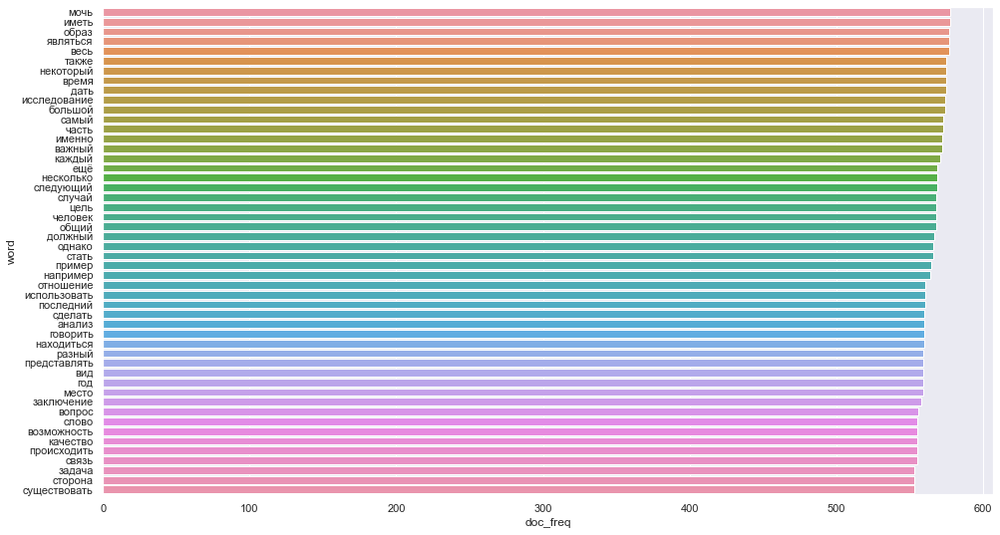

In [414]:
visual_df(freq_df)

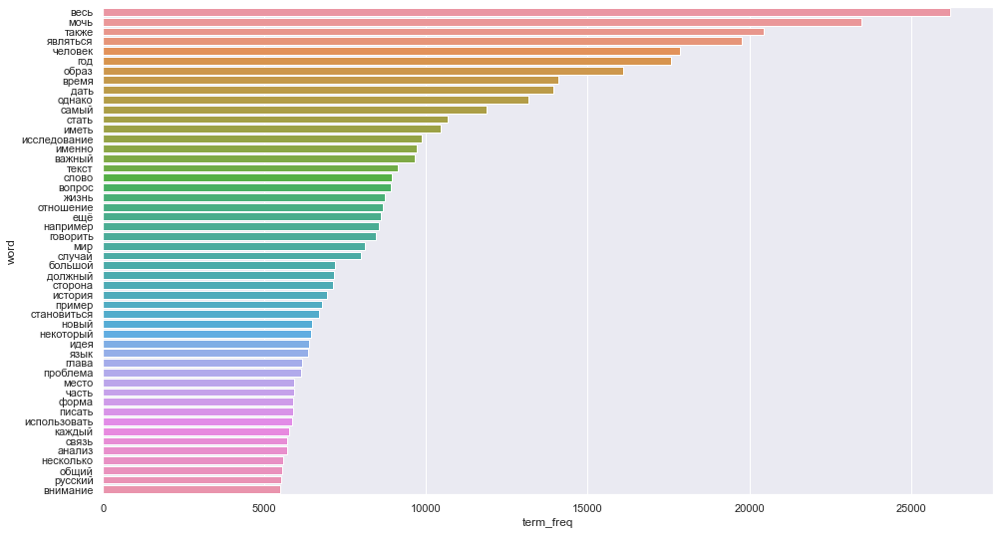

In [415]:
visual_df(freq_df, col='term_freq')

In [416]:
print(freq_df.head(200).word.values)

['мочь' 'иметь' 'образ' 'являться' 'весь' 'также' 'некоторый' 'время'
 'дать' 'исследование' 'большой' 'самый' 'часть' 'именно' 'важный'
 'каждый' 'ещё' 'несколько' 'следующий' 'случай' 'цель' 'человек' 'общий'
 'должный' 'однако' 'стать' 'пример' 'например' 'отношение' 'использовать'
 'последний' 'сделать' 'анализ' 'говорить' 'находиться' 'разный'
 'представлять' 'вид' 'год' 'место' 'заключение' 'вопрос' 'слово'
 'возможность' 'качество' 'происходить' 'связь' 'задача' 'сторона'
 'существовать' 'делать' 'внимание' 'новый' 'определённый' 'поэтому'
 'целое' 'необходимый' 'основный' 'связать' 'помощь' 'различный' 'лишь'
 'проблема' 'основа' 'значение' 'считать' 'представить' 'полный'
 'позволять' 'менее' 'роль' 'становиться' 'получить' 'форма' 'больший'
 'давать' 'следовать' 'отметить' 'отдельный' 'начало' 'число' 'хотя'
 'момент' 'называть' 'очередь' 'наш' 'наиболее' 'ряд' 'сказать' 'контекст'
 'иной' 'жизнь' 'привести' 'рассматривать' 'глава' 'первое' 'среди' 'идти'
 'видеть' 'особеннос

Filtering out words that appear in less than 5 documents or more than 50% of the documents.

In [23]:
dictionary.filter_extremes(no_below=5, no_above=0.5, keep_n=None)
len(dictionary)

28608

In [420]:
filtered_df = make_freq_df(dictionary)
filtered_df.head(20)

,word,term_freq,doc_freq
655,решать,625,289
729,сохранение,781,289
2902,читать,1074,289
626,разнообразный,649,289
2243,предположение,650,289
1145,впечатление,860,288
758,сущность,1165,288
2566,совпадать,625,288
1562,ключ,716,288
7052,критический,995,288


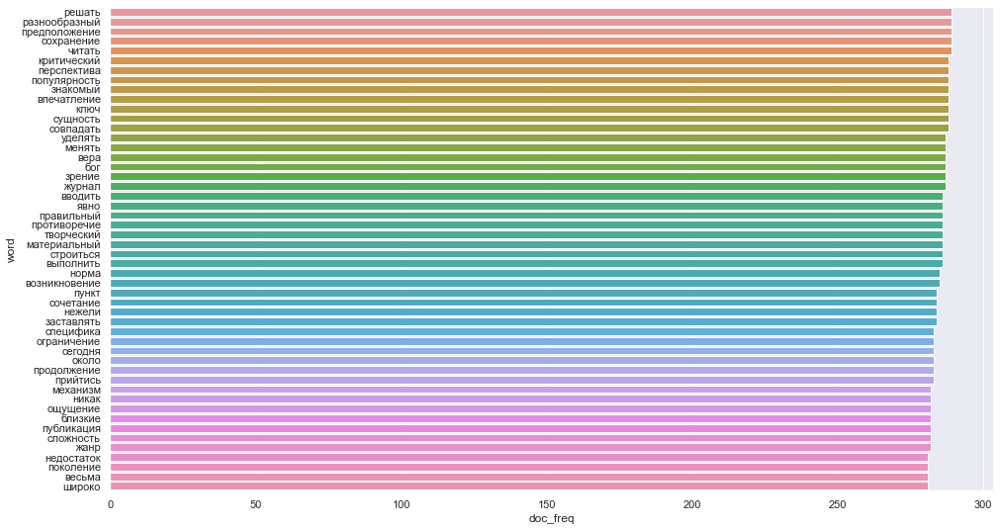

In [422]:
visual_df(filtered_df, top=50, col='doc_freq')

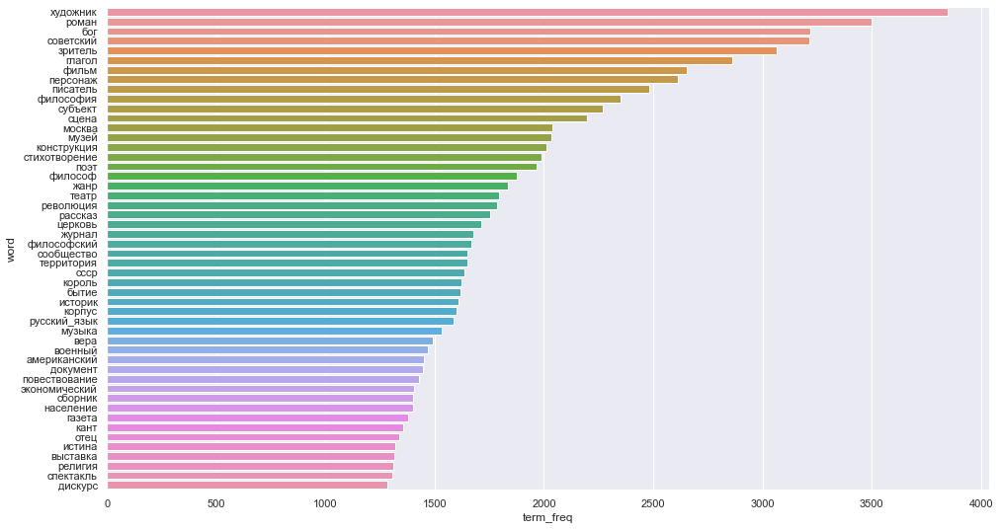

In [423]:
visual_df(filtered_df, top=50, col='term_freq')

## Corpus preparation

#### BOW

In [24]:
bow_corpus = [dictionary.doc2bow(doc) for doc in documents]

#### Tf-Idf

In [425]:
tfidf = models.TfidfModel(bow_corpus)
corpus_tfidf = tfidf[bow_corpus]

# LDA

In [426]:
def make_lda(corpus, dictionary, n_topics, a, e):
    lda_model = models.LdaMulticore(corpus, id2word=dictionary,
                                    passes=4, workers=3,
                                    chunksize=1000, eval_every=False,
                                    random_state=42,
                                    num_topics=n_topics,
                                    alpha=a,
                                    eta=e)
    
    return lda_model

def get_coherence(texts, dictionary, lda_model, coh='u_mass'):
    cm = models.coherencemodel.CoherenceModel(model=lda_model, 
                                              texts=texts,
                                              dictionary=dictionary,
                                              coherence=coh)   
                                                
    return cm.get_coherence()

### Tuning parametres

In [38]:
topic_range = range(10, 15)
alpha_range = list(np.arange(0.0, 1.2, 0.2))
eta_range = list(np.arange(0.0, 1.2, 0.2))

In [189]:
model_results = {'Topics': [],
                 'Alpha': [],
                 'Eta': [],
                 'Coherence': []}

In [190]:
for topic in tqdm(topic_range, desc='topics'):
    for alpha in tqdm(alpha_range, desc='alpha', leave=False):
        for eta in tqdm(eta_range, desc='eta', leave=False):
            
            lda = make_lda(bow_corpus, dictionary,
                           topic, alpha, eta)
            
            coher = get_coherence(documents, dictionary, lda, coh='c_v')
            
            lda.clear()
            
            model_results['Topics'].append(topic)
            model_results['Alpha'].append(alpha)
            model_results['Eta'].append(eta)
            model_results['Coherence'].append(coher)

In [30]:
# res = pd.DataFrame(model_results)
# res.to_csv('lda_tuning_results_2step.csv', index=False)

res = pd.read_csv('lda_tuning_results.csv')
res.sort_values(by='Coherence', ascending=False, inplace=True)
res.head(20)

,Topics,Alpha,Eta,Coherence
116,12,0.31,0.01,0.443011
199,17,0.31,0.91,0.427359
156,14,0.91,0.01,0.426138
135,13,0.31,0.91,0.422447
237,19,0.91,0.31,0.420610
109,11,0.91,0.31,0.418622
117,12,0.31,0.31,0.417051
14,5,0.91,0.61,0.415466
193,17,0.01,0.31,0.414625
192,17,0.01,0.01,0.410899


In [32]:
res2 = pd.read_csv('lda_tuning_results_2step.csv')
res2.sort_values(by='Coherence', ascending=False, inplace=True)
res2.head(20)

,Topics,Alpha,Eta,Coherence
96,13,0.5,0.5,0.430216
81,13,0.2,0.5,0.419226
20,10,0.5,0.4,0.415644
103,14,0.1,0.7,0.412629
19,10,0.4,0.8,0.412171
107,14,0.2,0.6,0.408958
2,10,0.1,0.6,0.407664
111,14,0.3,0.5,0.405292
76,13,0.1,0.5,0.402740
51,12,0.1,0.5,0.399410


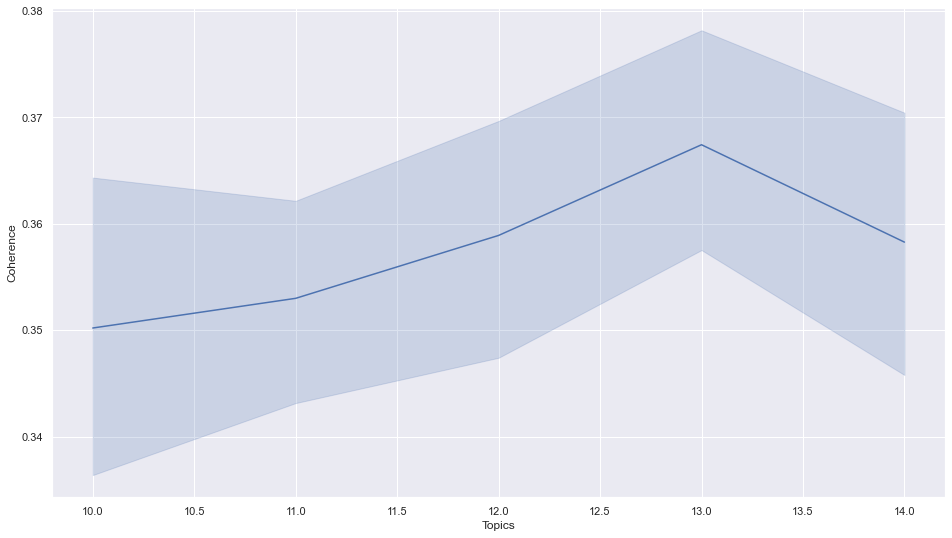

In [192]:
ax2 = sns.lineplot(x='Topics', y='Coherence', data=res)

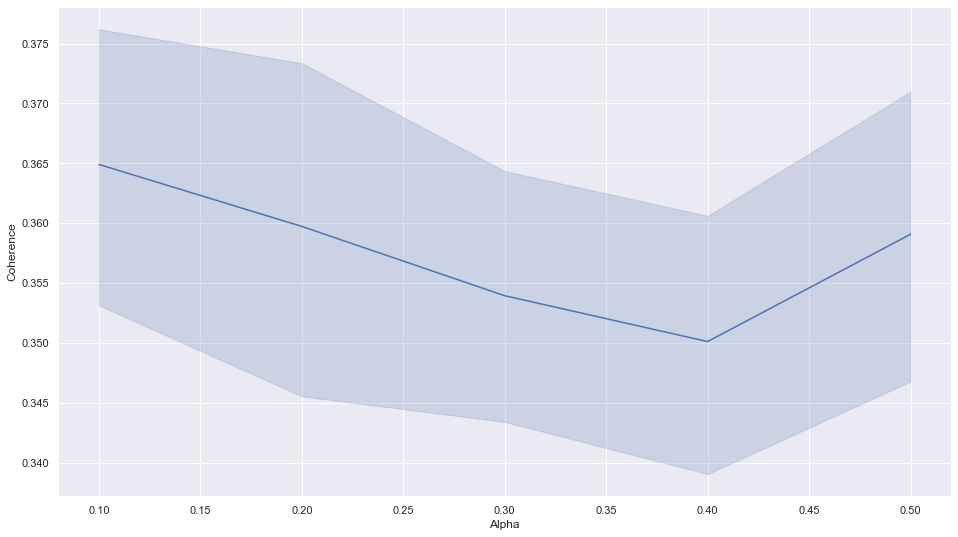

In [193]:
ax3 = sns.lineplot(x='Alpha', y='Coherence', data=res)

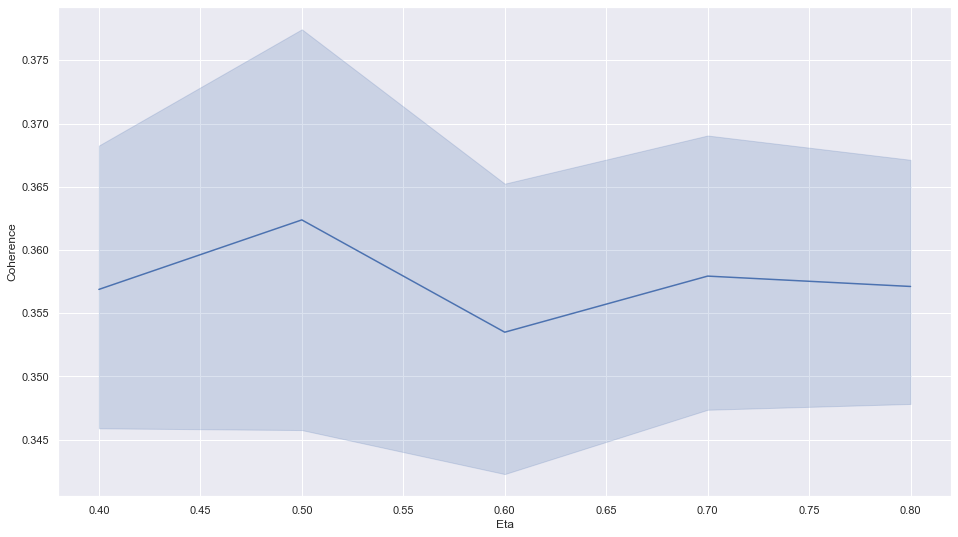

In [194]:
ax4 = sns.lineplot(x='Eta', y='Coherence', data=res)

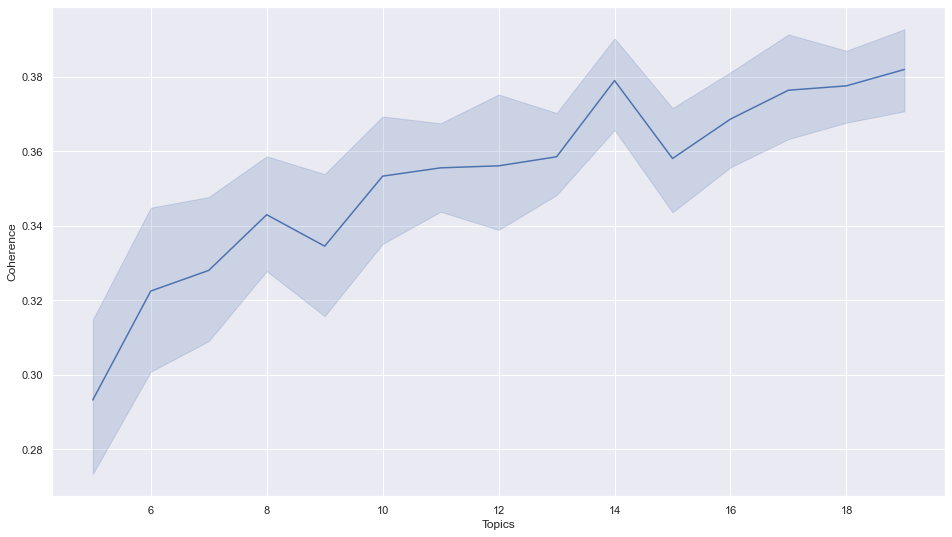

In [172]:
ax = sns.lineplot(x='Topics', y='Coherence', data=res)

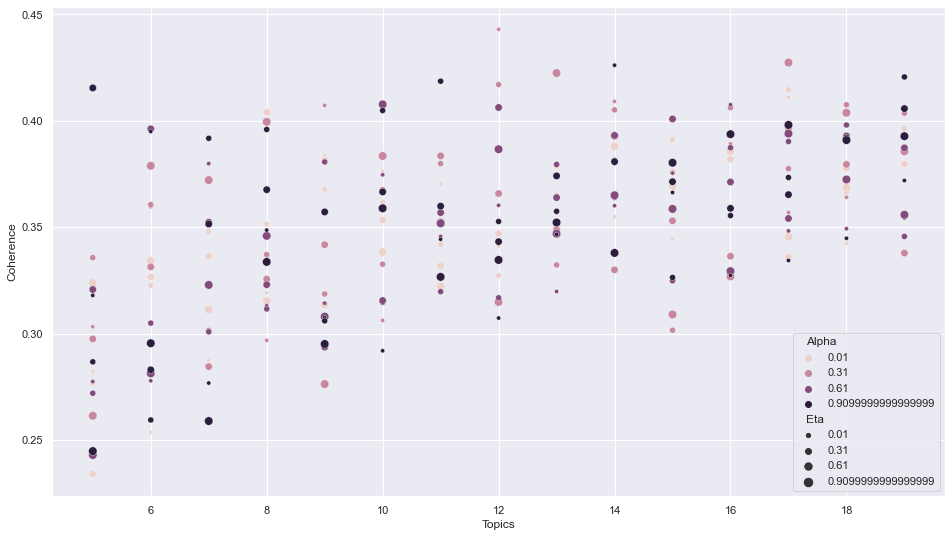

In [186]:
ax = sns.scatterplot(x='Topics', y='Coherence', 
                     hue='Alpha', size='Eta',
                     data=res)

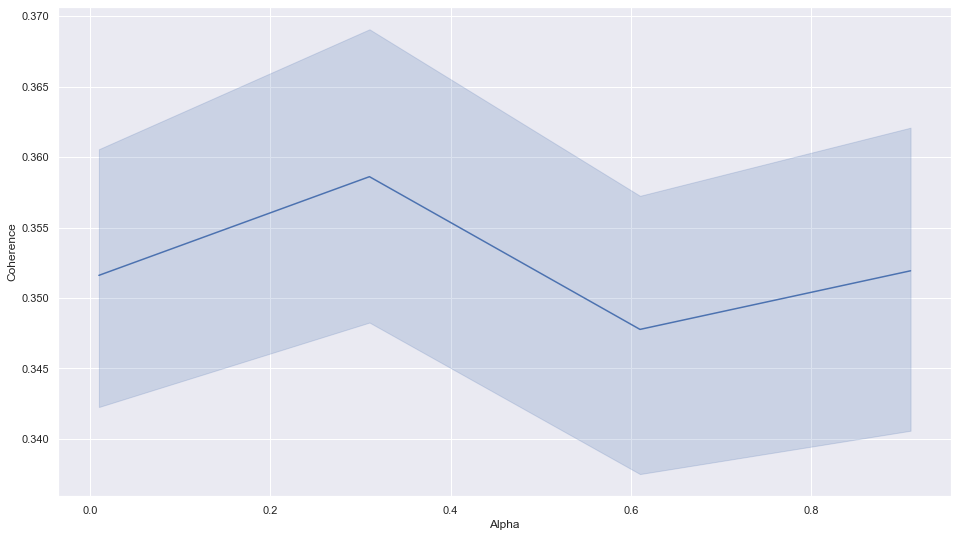

In [176]:
ax = sns.lineplot(x='Alpha', y='Coherence', data=res)

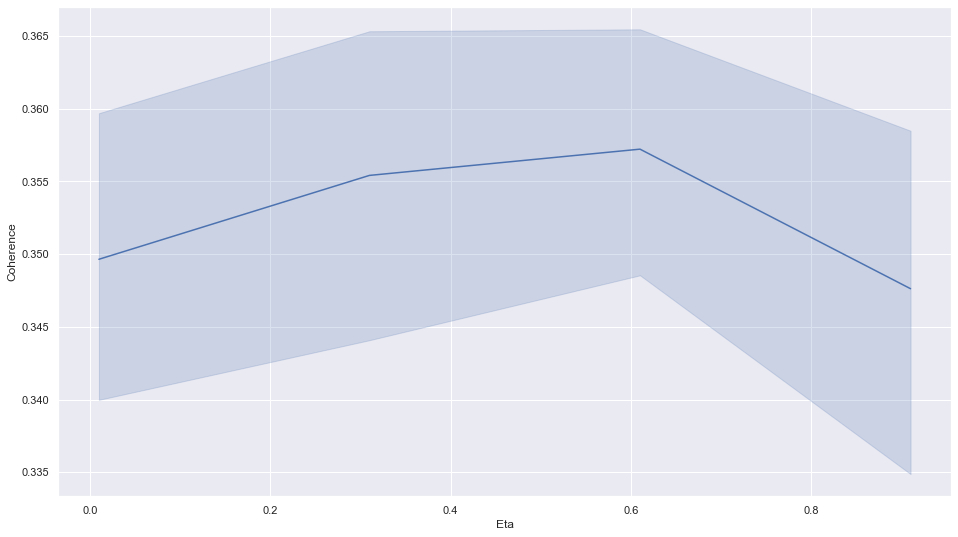

In [174]:
ax = sns.lineplot(x='Eta', y='Coherence', data=res)

In [45]:
model_results = {'Topics': [],
                 'Alpha': [],
                 'Eta': [],
                 'Coherence': []}

for topic in tqdm([100, 150, 200, 250, 300, 350, 400], desc='topics'): #range(10,110, 20)
    
    alpha = 'asymmetric'
    eta = 'auto'
    
    lda = make_lda(bow_corpus, dictionary,
                   topic, a=alpha, e=eta)
    
    coher = get_coherence(documents, dictionary, lda, coh='c_v')
    
    lda.clear()
    
    model_results['Topics'].append(topic)
    model_results['Alpha'].append(alpha)
    model_results['Eta'].append(eta)
    model_results['Coherence'].append(coher)
    
res1 = pd.DataFrame(model_results)
res1.to_csv('lda_tuning_results_100_400_50_asym_auto.csv', index=False)
res1

,Topics,Alpha,Eta,Coherence
0,100,asymmetric,auto,0.432553
1,150,asymmetric,auto,0.442144
2,200,asymmetric,auto,0.452347
3,250,asymmetric,auto,0.462322
4,300,asymmetric,auto,0.436589
5,350,asymmetric,auto,0.435735
6,400,asymmetric,auto,0.443457


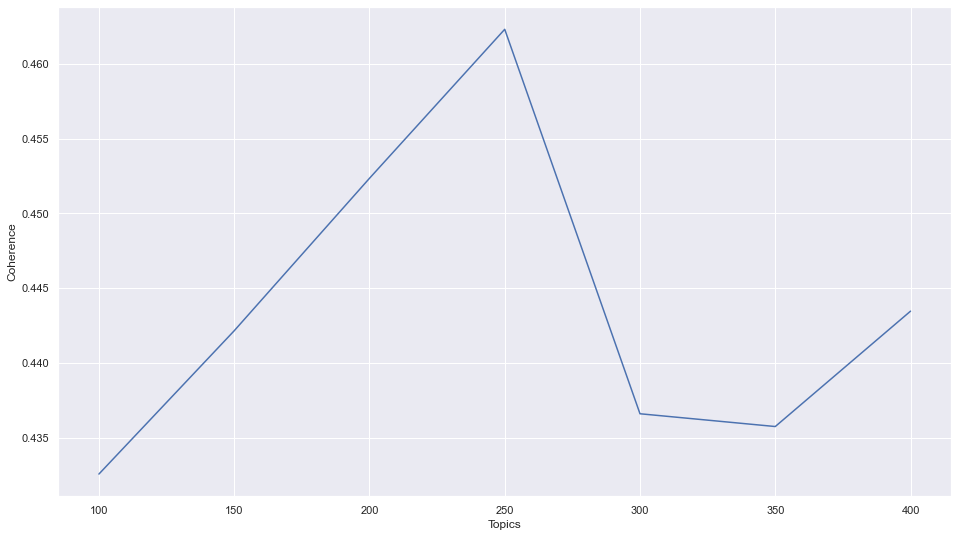

In [46]:
ax = sns.lineplot(x='Topics', y='Coherence', data=res1)

## Final model

In [14]:
temp_file = datapath("model50")
final_lda = models.LdaMulticore.load(temp_file)

In [606]:
final_lda = make_lda(bow_corpus, dictionary, 50, a='asymmetric', e='auto')
get_coherence(documents, dictionary, final_lda, coh='c_v')

0.4296693593926104

Looking at all the topics

In [608]:
for idx, t in final_lda.print_topics(-1):
    print('Topic: {} \nWords: {}'.format(idx, t))

Topic: 0 
Words: 0.005*"метафора" + 0.005*"говорящий" + 0.004*"роман" + 0.003*"религия" + 0.003*"шум" + 0.003*"эксперимент" + 0.002*"обещать" + 0.002*"философ" + 0.002*"мужчина" + 0.002*"вебер"
Topic: 1 
Words: 0.009*"советский" + 0.008*"ссср" + 0.003*"военный" + 0.003*"спорт" + 0.003*"документ" + 0.003*"революция" + 0.003*"советский_союз" + 0.003*"историк" + 0.003*"сталин" + 0.002*"сша"
Topic: 2 
Words: 0.019*"руссо" + 0.006*"шмитта" + 0.004*"мыслитель" + 0.004*"философ" + 0.004*"ибн" + 0.004*"психический" + 0.004*"мышление" + 0.003*"согласный" + 0.003*"философия" + 0.003*"суверен"
Topic: 3 
Words: 0.002*"счастие" + 0.002*"счастливый" + 0.002*"дюма" + 0.002*"бог" + 0.002*"готье" + 0.002*"музей" + 0.001*"роман" + 0.001*"советский" + 0.001*"сцена" + 0.001*"художник"
Topic: 4 
Words: 0.016*"король" + 0.014*"парламент" + 0.013*"музыка" + 0.007*"шопенгауэр" + 0.005*"яков" + 0.005*"воля" + 0.005*"пионер" + 0.004*"опера" + 0.004*"кок" + 0.004*"acc"
Topic: 5 
Words: 0.008*"роман" + 0.004*"пет

In [609]:
temp_file = datapath("model50")
final_lda.save(temp_file)

Some functions for manual exploration of the model's results

In [504]:
def show_topwords_for_toptopics_for_word(word, topn=20):
    x = final_lda.get_term_topics(dictionary.token2id[word])
    for i in x:
        print(final_lda.show_topic(i[0], topn=topn))
        print('-------')

In [612]:
show_topwords_for_toptopics_for_word('корпус')

[('корпус', 0.017278805), ('алгоритм', 0.007387009), ('параметр', 0.005070606), ('разметка', 0.0043638223), ('обучение', 0.003317731), ('парсер', 0.0032597035), ('метрика', 0.0031816282), ('формат', 0.0031673233), ('точность', 0.0031557756), ('учащийся', 0.0031496957), ('хрестоматия', 0.0030258554), ('автоматический', 0.0029813063), ('тег', 0.0029355825), ('документ', 0.002910475), ('классификатор', 0.0028466682), ('синтаксический', 0.0027949596), ('обработка', 0.0027122668), ('токен', 0.0026748376), ('файл', 0.002640989), ('пользователь', 0.0026318885)]
-------


In [510]:
def get_topic_distribution(bow_doc):
    topics = final_lda.get_document_topics(bow_doc)
    
    words = []
    for top in topics:
        words.append(', '.join([t[0] for t in final_lda.show_topic(top[0], topn=10)]))
        
    return pd.DataFrame({'top_words': words,
                         'prob': [top[1] for top in topics]},
                        index=[top[0] for top in topics]).sort_values('prob', ascending=False)

In [511]:
x = files.index('206733706.txt')
test_text = texts[x]
test_file = files[x]
test_title = vkrs[test_file.split('.')[0]]['title']
test_abstract = vkrs[test_file.split('.')[0]]['abstract']
test_bow = bow_corpus[x]

print(test_title)
print(test_abstract)

Автоматический анализ изменений тональности новостных текстов при возникновении новых сведений
Благодаря сети Интернет современные люди получили возможность мгновенно получать ответы почти на любые вопросы. Тем не менее, в ряде случаев для получения даже общего представления о предмете вопроса людям все ещё приходится анализировать большие объёмы информации, часто разбросанные по множеству источников. Примером может служить анализ новостных статей о ещё не выпущенных в продажу товарах, в частности цифровой технике, которую человек может планировать приобрести. При этом людей часто интересуют именно отзывы других пользователей. В связи с этим возникает задача автоматического мониторинга источников новостных статей с целью выделения наиболее релевантной информации о тех или иных продуктах, а также автоматического анализа отношения к ним на основе комментариев читателей. В данной работе описывается подход к реализации такой системы. <br><br>В системе используется тематическое моделировани

In [617]:
get_topic_distribution(test_bow).head(10)

,top_words,prob
19,"гласный, барокко, михайлов, музыка, агент, фил...",0.468419
17,"корпус, алгоритм, параметр, разметка, обучение...",0.411820
10,"глагол, конструкция, русский_язык, студент, эк...",0.100997
15,"наречие, конструкция, феликс, говорящий, сущес...",0.018169


Getting the vectors

In [25]:
vectors = []

for bow in tqdm(bow_corpus):
    dist = final_lda.get_document_topics(bow, minimum_probability=0.0)
    vectors.append([d[1] for d in dist])

Getting the metadata for the texts and joining everything into a dataframe.

In [461]:
with open('fgn_structure.json', 'r', encoding='utf-8') as f:
    fgn_structure = json.load(f)
    
fgn_structure

{'История': {'dep': 'Школа исторических наук'},
 'Филология': {'dep': 'Школа филологических наук'},
 'Фундаментальная и компьютерная лингвистика': {'dep': 'Школа лингвистики'},
 'Философия': {'dep': 'Школа философии'},
 'Культурология': {'dep': 'Школа культурологии'},
 'Визуальная культура': {'dep': 'Школа культурологии'},
 'История искусств': {'dep': 'Школа исторических наук'},
 'Философская антропология': {'dep': 'Школа философии'},
 'Компьютерная лингвистика': {'dep': 'Школа лингвистики'},
 'Литературное мастерство': {'dep': 'Школа филологических наук'},
 'Прикладная культурология': {'dep': 'Школа культурологии'},
 'История художественной культуры и рынок искусства': {'dep': 'Школа исторических наук'},
 'Теория языка и компьютерная лингвистика': {'dep': 'Школа лингвистики'},
 'Компаративистика: русская литература в кросс-культурной перспективе': {'dep': 'Школа филологических наук'},
 'Историческое знание': {'dep': 'Школа исторических наук'},
 'Языковая политика в условиях этнокульту

In [1427]:
def get_id(file):
    return file.split('.')[0]

def get_title(ID):
    return vkrs[ID]['title']

def get_title_en(ID):
    
    title = vkrs[ID]['en_title']
    
    if title is None:
        title = vkrs[ID]['title']
    
    return title

def get_prog(ID):
    return vkrs[ID]['learn_program_title']

def get_prog_en(ID):
    return vkrs[ID]['en_learn_program_title']

def get_level(ID):
    return vkrs[ID]['en_level']

def get_school(prog):
    return fgn_structure[prog]['dep']


schools_eng = {
    "Школа исторических наук": "School of History",
    "Школа культурологии": "School of Cultural Studies",
    "Школа лингвистики": "School of Linguistics",
    "Школа филологических наук": "School of Philological Studies",
    "Школа философии": "School of Philosophy",
}

def get_year(ID):
    return vkrs[ID]['year']

def get_raiting(ID):
    return vkrs[ID]['rating']

def translate(s):
    return schools_eng[s]

In [620]:
data = pd.DataFrame({'File': [], 
                     'ID': [],
                     'Title': [],
                     'Program': [],
                     'Level': [],
                     'School': [],
                     'vector': []
                    })
data.File = files
data.vector = vectors
data.ID = data.File.apply(get_id)
data.Title = data.ID.apply(get_title_en)
data.Program = data.ID.apply(get_prog_en)
data.Level = data.ID.apply(get_level)
data.School = data.Program.apply(get_school)
data.head()

,File,ID,Title,Program,Level,School,vector
0,153006854.txt,153006854,Разработка словаря для автоматического извлече...,Фундаментальная и компьютерная лингвистика,Bachelor,Школа лингвистики,"[3.5413806e-05, 0.049679708, 2.760567e-05, 2.4..."
1,153007241.txt,153007241,Травелоги В. П. Аксенова 1970-х гг.: поэтика и...,Филология,Bachelor,Школа филологических наук,"[1.6487642e-05, 1.4444807e-05, 1.2852399e-05, ..."
2,153007355.txt,153007355,Разграничение значений предлогов В (включеннос...,Фундаментальная и компьютерная лингвистика,Bachelor,Школа лингвистики,"[4.3028245e-05, 3.769703e-05, 3.3541284e-05, 3..."
3,153007391.txt,153007391,«Science art: трансформация научного дискурса ...,Визуальная культура,Master,Школа культурологии,"[0.010373313, 3.1613006e-05, 2.812796e-05, 2.5..."
4,153007477.txt,153007477,Разработка учебного модуля по глаголам движени...,Фундаментальная и компьютерная лингвистика,Bachelor,Школа лингвистики,"[3.2027696e-05, 2.805945e-05, 2.4966155e-05, 2..."


In [1440]:
data['Title_ru'] = data.ID.apply(get_title)
data['Program_ru'] = data.ID.apply(get_prog)
data['School_ru'] = data.Program_ru.apply(get_school)
data['Year'] = data.ID.apply(get_year)

data.School = data.School_ru.apply(translate)

Looking at some statistics

In [1460]:
data.groupby(['School', 'Year']).agg({
    'Title': 'count'
}).unstack()

Title                         
Year                            2015 2016 2017 2018 2019 2020
School                                                       
School of Cultural Studies         8   30   28   20   12    5
School of History                  1   30   30   18   26   38
School of Linguistics             16    7   37   10   12   12
School of Philological Studies     5   12   27   27   22   49
School of Philosophy               6   12   24   20   21   13

In [1461]:
data.groupby(['School', 'Level']).agg({
    'Title': 'count'
}).unstack()

Title       
Level                          Bachelor Master
School                                        
School of Cultural Studies           67     36
School of History                   112     31
School of Linguistics                71     23
School of Philological Studies      113     29
School of Philosophy                 75     21

<AxesSubplot:xlabel='School'>

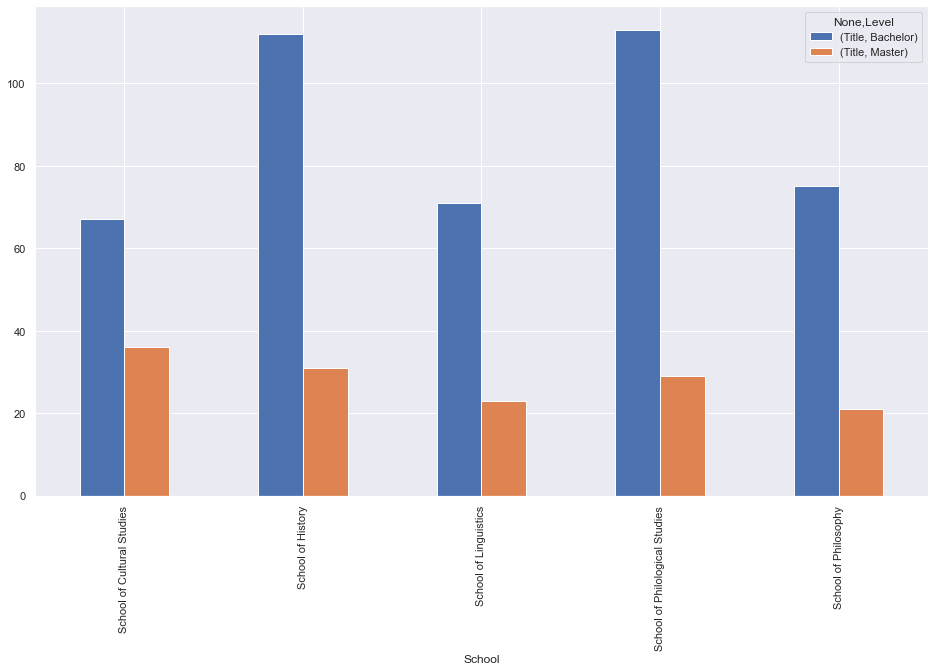

In [1462]:
data.groupby(['School', 'Level']).agg({
    'Title': 'count'
}).unstack().plot.bar()

In [1497]:
stat_data_programme = pd.DataFrame(data.groupby('Program')['Title'].count()).sort_values('Title', ascending=False)
stat_data_programme

,Title
Program,
Philology,113
History,85
Philosophy,75
Fundamental and Computational Linguistics,71
Cultural Studies,67
History of Arts,27
Visual Culture,21
Applied Cultural Studies,15
Philosophical Anthropology,14


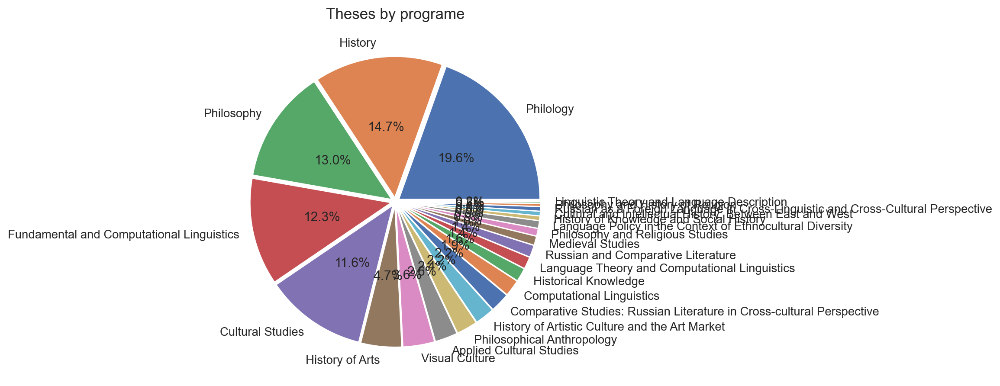

In [1498]:
pie, ax = plt.subplots(figsize=[10,6], dpi=180)
labels = stat_data_programme.index
plt.pie(x=stat_data_programme.Title, autopct="%.1f%%", explode=[0.03]*len(labels), labels=labels, pctdistance=0.5)
plt.title("Theses by programe", fontsize=14)
plt.savefig('proram_piechart.jpeg')
plt.show()

In [1476]:
stat_data_school = pd.DataFrame(data.groupby('School')['Title'].count()).sort_values('Title', ascending=False)
stat_data_school

,Title
School,
School of History,143
School of Philological Studies,142
School of Cultural Studies,103
School of Philosophy,96
School of Linguistics,94


Settigt colors for a uniform visual repressentation

In [1489]:
colors = {'Школа исторических наук': '#636EFA',
 'Школа культурологии': '#EF553B',
 'Школа лингвистики': '#00CC96',
 'Школа филологических наук': '#AB63FA',
 'Школа философии': '#FFA15A'}

In [128]:
en_colors = dict([(s, c) for s,c in zip(sorted(data.School.unique()), px.colors.qualitative.Plotly[:5])])
    
en_colors

{'School of Cultural Studies': '#636EFA',
 'School of History': '#EF553B',
 'School of Linguistics': '#00CC96',
 'School of Philological Studies': '#AB63FA',
 'School of Philosophy': '#FFA15A'}

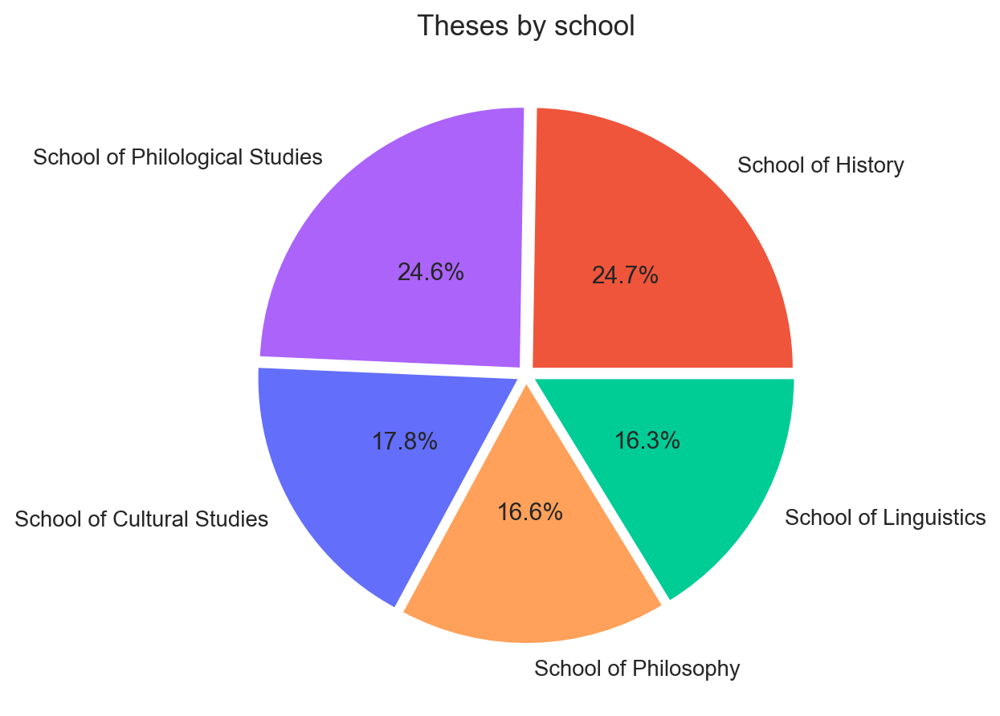

In [1507]:
pie, ax = plt.subplots(figsize=[10,6], dpi=180)
labels = stat_data_school.index
plt.pie(x=stat_data_school.Title, autopct="%.1f%%", explode=[0.03]*5, labels=labels, pctdistance=0.5,
       colors =[en_colors[l] for l in labels])
plt.title("Theses by school", fontsize=14)
plt.savefig('school_piechart.jpeg')
plt.show()

In [1635]:
for s, g in data.groupby('School'):
    print(f'{s}:')
    for p in g.Program.unique():
        print('\t', p)

School of Cultural Studies:
	 Visual Culture
	 Applied Cultural Studies
	 Cultural Studies
School of History:
	 History of Knowledge and Social History
	 History
	 History of Artistic Culture and the Art Market
	 Historical Knowledge
	 History of Arts
	 Medieval Studies
School of Linguistics:
	 Fundamental and Computational Linguistics
	 Computational Linguistics
	 Language Theory and Computational Linguistics
	 Russian as a Foreign Language in Cross-Linguistic and Cross-Cultural Perspective
	 Linguistic Theory and Language Description
School of Philological Studies:
	 Philology
	 Comparative Studies: Russian Literature in Cross-cultural Perspective
	 Cultural and Intellectual History: Between East and West
	 Language Policy in the Context of Ethnocultural Diversity
	 Russian and Comparative Literature
School of Philosophy:
	 Philosophical Anthropology
	 Philosophy
	 Philosophy and Religious Studies
	 Philosophy and History of Religion


C:\ProgramData\Anaconda3\lib\site-packages\ipykernel\ipkernel.py:287: DeprecationWarning:

`should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.



# Visualization

In [178]:
%matplotlib inline
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
import seaborn as sns

from sklearn.decomposition import PCA, TruncatedSVD
from sklearn.manifold import TSNE
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis

In [625]:
np.random.seed(43)

Exploring the most inportatnt topics for each school using a Logistic Regression

In [1472]:
X = vectors
y = data.School
clf = LogisticRegression(random_state=0, multi_class='multinomial').fit(X, y)
feature_importances_lreg = clf.coef_

for i, s in enumerate(sorted(data.School.unique())):
    print(s)
    for ind in np.argsort(-feature_importances_lreg[i])[:10]:
        x = ', '.join([w[0] for w in final_lda.show_topic(ind, topn=5)])
        print(feature_importances_lreg[i][ind], '\t', x,)
        
    print('----------')

School of Cultural Studies
2.5939254083769234 	 король, газета, толстой, историк, правительство
2.055191156701277 	 советский, ссср, военный, спорт, документ
1.8250179225713132 	 рубенс, художник, выполнить, портрет, мавзолей
1.7443224485903976 	 художник, изобразить, мастер, композиция, итальянский
1.5628192147774067 	 храм, польский, архитектор, марка, князь
1.2909069980251406 	 музей, художник, выставка, посетитель, зритель
1.2005788395136283 	 бог, князь, святой, константин, сократ
0.842710507922798 	 бог, рильке, молл, ангел, урна
0.6727720629758619 	 художник, здание, музыка, фотография, фрагмент
0.6209975021368711 	 булгаков, запись, роман, достоевский, дочь
----------
School of History
2.0790912426402004 	 фильм, зритель, режиссёр, спектакль, театр
1.4791515271619156 	 флешмоб, сообщество, респондент, интервью, москва
1.459256490754906 	 музей, художник, выставка, посетитель, зритель
1.288933579733873 	 субъект, бытие, крепостной, индивид, философия
1.1422777790051437 	 фильм, 

### PCA

#### 2D

In [626]:
pca = PCA(n_components=2)
pca_result = pca.fit_transform(vectors)
data['pca-one'] = pca_result[:,0]
data['pca-two'] = pca_result[:,1] 
#data['pca-three'] = pca_result[:,2]
print('Explained variation per principal component: {}'.format(pca.explained_variance_ratio_))

Explained variation per principal component: [0.09154741 0.07267948]


<AxesSubplot:xlabel='pca-one', ylabel='pca-two'>

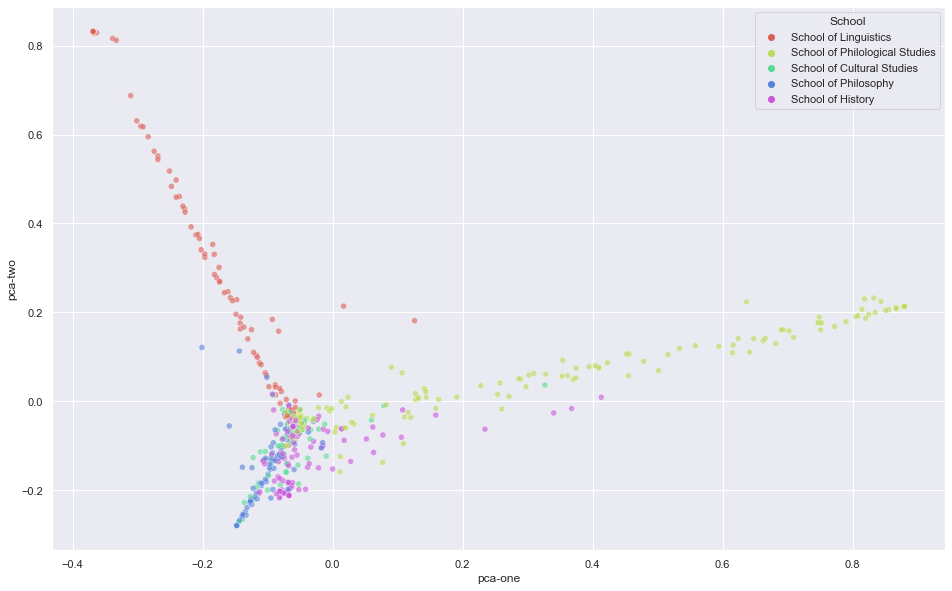

In [1469]:
plt.figure(figsize=(16,10))
sns.scatterplot(
    x="pca-one", y="pca-two",
    hue="School",
    palette=sns.color_palette("hls", 5),
    data=data,
    legend="full",
    alpha=0.6
)
#plt.savefig('feature_correlation.jpeg')

#### 3D

For the interactive graphs via Plotly please see [the website](https://polyankaglade.github.io/Theses_LDA/), as they may not work in the uloaded version of this notebook.

Explained variation per principal component: [0.09154741 0.07267949 0.05588136]


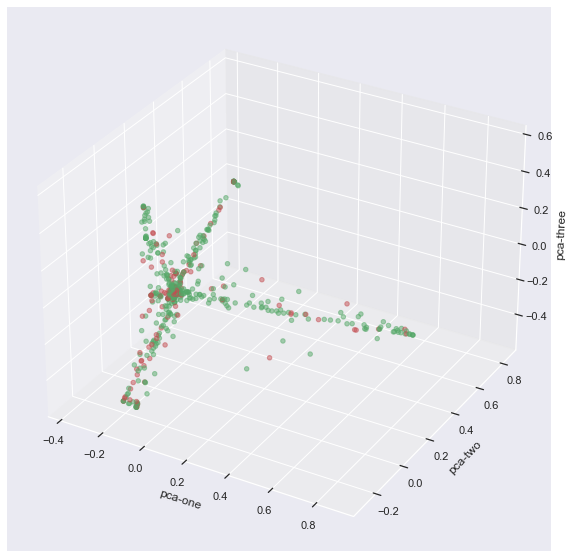

In [647]:
pca = PCA(n_components=3)
pca_result = pca.fit_transform(vectors)
data['pca-one'] = pca_result[:,0]
data['pca-two'] = pca_result[:,1] 
data['pca-three'] = pca_result[:,2]
print('Explained variation per principal component: {}'.format(pca.explained_variance_ratio_))

ax = plt.figure(figsize=(16,10)).gca(projection='3d')
ax.scatter(
    xs=data["pca-one"], 
    ys=data["pca-two"], 
    zs=data["pca-three"], 
    c=['g' if d == "Bachelor" else 'r' for d in data["Level"]], 
    alpha=0.5
)
ax.set_xlabel('pca-one')
ax.set_ylabel('pca-two')
ax.set_zlabel('pca-three')
plt.show()

In [648]:
fig = px.scatter_3d(data.sort_values('School'), 
                    x='pca-two', 
                    y='pca-one', 
                    z='pca-three',
                    color='School',
                    symbol='Level',
                    opacity=0.9,
                    hover_data=["Program", "Title"]
                   )

fig.update_traces(marker=dict(size=5),
                  selector=dict(mode='markers'))

fig.show()

In [873]:
pca_5 = PCA(n_components=5)
pca_result_5 = pca_5.fit_transform(vectors)

for i in range(5):
    data[f'pca-5D-{i+1}'] = pca_result_5[:,i]

print('Explained variation per principal component: {}'.format(pca_5.explained_variance_ratio_))
sum(pca_5.explained_variance_ratio_)

Explained variation per principal component: [0.09154739 0.07267917 0.05588021 0.04721005 0.04614606]


0.31346288594209937

In [1503]:
centroids_5D = pd.DataFrame(columns=['School', '5d1', '5d2', '5d3', '5d4', '5d5'])

for school, g in data.groupby('School'):
    
    d1 = g['pca-5D-1'].mean()
    d2 = g['pca-5D-2'].mean()
    d3 = g['pca-5D-3'].mean()
    d4 = g['pca-5D-4'].mean()
    d5 = g['pca-5D-5'].mean()
    
    centroids_5D = centroids_5D.append({'School': school,
                                  '5d1': d1,
                                  '5d2': d2,
                                  '5d3': d3,
                                  '5d4': d4,
                                  '5d5': d5
                                 },
                                 ignore_index=True)
    
centroids_5D['color'] = px.colors.qualitative.Plotly[:5]
centroids_5D

,School,5d1,5d2,5d3,5d4,5d5,color
0,School of Cultural Studies,-0.063496,-0.087226,0.006159,0.092002,0.039138,#636EFA
1,School of History,-0.044190,-0.107991,0.143910,-0.012085,-0.029559,#EF553B
2,School of Linguistics,-0.187065,0.335932,0.000562,-0.015611,0.001371,#00CC96
3,School of Philological Studies,0.278176,0.039585,-0.003612,0.012383,-0.010637,#AB63FA
4,School of Philosophy,-0.094351,-0.133039,-0.216181,-0.083739,0.016431,#FFA15A


In [1590]:
fig = px.scatter_3d(data.sort_values('School'), 
                    x='pca-5D-1', 
                    y='pca-5D-2', 
                    z='pca-5D-3',
                    color='School',
                    symbol='Level',
                    opacity=0.6,
                    custom_data=['School', 'Program', 'Level', 'Title'],
                    #color_discrete_sequence=px.colors.qualitative.Set2,
                    title="Thesis spatial representation from 5-component PCA of 50 topics from LDA"
                   )

fig.update_traces(marker=dict(size=5),
                  selector=dict(mode='markers'))

for i in range(5):
    fig.add_scatter3d(
        x=[centroids_5D['5d1'][i]],
        y=[centroids_5D['5d2'][i]],
        z=[centroids_5D['5d3'][i]],
        
                mode="markers",
                name=f"{centroids_5D['School'][i]}, Centroid",
                marker=dict(size=10, color=centroids_5D['color'][i],
                            symbol='cross', opacity=0.8,
                           line=dict(width=2,
                                     color='black'))
               )
    
text = "<br>".join([#"School: %{customdata[0]}",
                    "Level: %{customdata[2]}",
                    "Program: %{customdata[1]}",
                    "Title: %{customdata[3]}",
                    "<extra></extra>"
                   ])

fig.update_traces(marker_size=5,
                  hovertemplate=text,
                  selector=dict(mode='markers'))

fig.update_traces(marker_size=8, marker_line_width=1, marker_opacity=0.9,
                  hovertemplate="Centroid",
                  selector=dict(marker_symbol="cross"), overwrite=True)

fig.update_layout(margin=dict(l=0, r=0, b=20, t=50))
fig.show()

In [1591]:
fig.write_html("3D_centroids.html")

In [1524]:
fig = px.scatter_3d(data.sort_values('School'), 
                    x='pca-5D-3', 
                    y='pca-5D-4', 
                    z='pca-5D-5',
                    color='School',
                    symbol='Level',
                    opacity=0.7,
                    hover_data=["Program", "Title"]
                   )

fig.update_traces(marker=dict(size=5),
                  selector=dict(mode='markers'))

for i in range(5):
    fig.add_scatter3d(
        x=[centroids_5D['5d3'][i]],
        y=[centroids_5D['5d4'][i]],
        z=[centroids_5D['5d5'][i]],
                mode="markers",
                name=f"{centroids_5D['School'][i]}, Centroid",
                marker=dict(size=10, color=centroids_5D['color'][i],
                            symbol='cross', opacity=0.8,
                           line=dict(width=2,
                                     color='black'))
               )
fig.update_layout(margin=dict(l=0, r=0, b=0, t=0))
fig.show()

In [883]:
fig = px.scatter(data.sort_values('School'), 
                    x='pca-5D-1', 
                    y='pca-5D-2', 
                    color='School',
                    symbol='Level',
                    opacity=0.7,
                    hover_data=["Program", "Title"]
                   )

fig.update_traces(marker=dict(size=5),
                  selector=dict(mode='markers'))

for i in range(5):
    fig.add_scatter(
        x=[centroids_5D['5d1'][i]],
        y=[centroids_5D['5d2'][i]],
                mode="markers",
                name=centroids_5D['School'][i],
                marker=dict(size=10, color=centroids_5D['color'][i],
                            symbol='cross', opacity=0.8,
                           line=dict(width=2,
                                     color='black'))
               )
fig.update_layout(margin=dict(l=0, r=0, b=0, t=0))
fig.show()

In [887]:
combinations = []

for i in range(5):
    for ii in range(5):
        
        if i == ii:
            continue
        
        if i > ii:
            combinations.append((ii, i))
        else:
            combinations.append((i, ii))
            
comb = sorted(list(set(combinations)))
comb

[(0, 1),
 (0, 2),
 (0, 3),
 (0, 4),
 (1, 2),
 (1, 3),
 (1, 4),
 (2, 3),
 (2, 4),
 (3, 4)]

In [1511]:
centroids_5D

,School,5d1,5d2,5d3,5d4,5d5,color
0,School of Cultural Studies,-0.063496,-0.087226,0.006159,0.092002,0.039138,#636EFA
1,School of History,-0.044190,-0.107991,0.143910,-0.012085,-0.029559,#EF553B
2,School of Linguistics,-0.187065,0.335932,0.000562,-0.015611,0.001371,#00CC96
3,School of Philological Studies,0.278176,0.039585,-0.003612,0.012383,-0.010637,#AB63FA
4,School of Philosophy,-0.094351,-0.133039,-0.216181,-0.083739,0.016431,#FFA15A


In [1512]:
slider_list = []

for i, ii in comb:
    d_copy = data.copy()
    d_copy['x'] = d_copy[f'pca-5D-{i+1}']
    d_copy['y'] = d_copy[f'pca-5D-{ii+1}']
    d_copy['x + y '] = f' component {i+1} + component {ii+1}'
    d_copy['size'] = 5
    d_copy['symbol'] = ['circle' if l == 'Bachelor' else 'diamond' for l in d_copy['Level']]
    for s in range(5):
        d_copy = d_copy.append({'School': centroids_5D.School[s],
                       'x': centroids_5D[f'5d{i+1}'][s],
                       'y': centroids_5D[f'5d{ii+1}'][s],
                       'x + y ': f' component {i+1} + component {ii+1}',
                       'Level': 'Centroid',
                       'size': 10,
                       'symbol': 'cross',
                        'Program': 'Centriod',
                        'Title': 'Centriod'
                      }, ignore_index=True)
        
    slider_list.append(d_copy.sort_values('School'))
    d_copy = None

    
slider_df = pd.concat(slider_list, ignore_index=True)
slider_df[['x', 'y']].describe()

,x,y
count,5830.000000,5830.000000
mean,-0.000077,-0.000008
std,0.216912,0.179602
min,-0.525315,-0.636317
25%,-0.089596,-0.056436
50%,-0.050203,-0.007415
75%,0.030750,0.045318
max,0.880168,0.831873


In [1513]:
slider_df[slider_df.Level == 'Centroid']

,File,ID,Title,Program,Level,School,vector,pca-one,pca-two,pca-three,...,School_ru,Title_ru,Program_ru,School_r,Year,x,y,x + y,size,symbol
77,NaN,NaN,Centriod,Centriod,Centroid,School of Cultural Studies,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,-0.063496,-0.087226,component 1 + component 2,10,cross
184,NaN,NaN,Centriod,Centriod,Centroid,School of History,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,-0.044190,-0.107991,component 1 + component 2,10,cross
249,NaN,NaN,Centriod,Centriod,Centroid,School of Linguistics,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,-0.187065,0.335932,component 1 + component 2,10,cross
430,NaN,NaN,Centriod,Centriod,Centroid,School of Philological Studies,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,0.278176,0.039585,component 1 + component 2,10,cross
582,NaN,NaN,Centriod,Centriod,Centroid,School of Philosophy,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,-0.094351,-0.133039,component 1 + component 2,10,cross
660,NaN,NaN,Centriod,Centriod,Centroid,School of Cultural Studies,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,-0.063496,0.006159,component 1 + component 3,10,cross
767,NaN,NaN,Centriod,Centriod,Centroid,School of History,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,-0.044190,0.143910,component 1 + component 3,10,cross
832,NaN,NaN,Centriod,Centriod,Centroid,School of Linguistics,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,-0.187065,0.000562,component 1 + component 3,10,cross
1013,NaN,NaN,Centriod,Centriod,Centroid,School of Philological Studies,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,0.278176,-0.003612,component 1 + component 3,10,cross
1165,NaN,NaN,Centriod,Centriod,Centroid,School of Philosophy,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,-0.094351,-0.216181,component 1 + component 3,10,cross


In [1514]:
slider_df.to_csv('slider_data.tsv', sep='\t')

In [1534]:
fig = px.scatter(slider_df, 
                    x='x', 
                    y='y', 
                    color='School',
                    symbol='Level',
                    opacity=0.6,
                    hover_data=["Program", "Title"],
                  animation_frame="x + y ",
                 symbol_sequence = ['circle', 'diamond', 'cross'],
                 title="Thesis spatial representation from 5-component PCA",
                 custom_data=['School', 'Program', 'Level', 'Title']
                   )

text = "<br>".join([#"School: %{customdata[0]}",
                    "Level: %{customdata[2]}",
                    "Program: %{customdata[1]}",
                    "Title: %{customdata[3]}",
                    "<extra></extra>"
                   ])

center_text = "Centroid %{customdata[0]}<extra></extra>"

for f in fig.frames:
    for d in f.data:
        if d.marker.symbol == 'cross':
            d.hovertemplate = center_text
        else:
            d.hovertemplate = text

fig.update_traces(marker_size=5,
                  selector=dict(mode='markers'))

fig.update_traces(marker_size=8, marker_line_width=1, marker_opacity=0.9,
                  #hovertemplate="Centroid %{customdata[0]}<extra></extra>",
                  selector=dict(marker_symbol="cross"), overwrite=True)


fig.update_layout(margin=dict(l=0, r=0, b=20, t=50))

fig.update_xaxes(
    range=(-0.6, 1),
)
fig.update_yaxes(
    range=(-0.8, 1),
)
fig.show()

In [1535]:
fig.write_html("slider_with_centroids.html")

In [900]:
import dash
import dash_core_components as dcc
import dash_html_components as html

app = dash.Dash()
app.layout = html.Div([
    dcc.Graph(figure=fig)
])

app.run_server(debug=True, use_reloader=False)  # Turn off reloader if inside Jupyter

Dash is running on http://127.0.0.1:8050/

 * Serving Flask app "__main__" (lazy loading)
 * Environment: production
   Use a production WSGI server instead.
 * Debug mode: on


In [1536]:
fig = px.scatter(slider_df, 
                    x='x', 
                    y='y', 
                    color='Level',
                    symbol='School',
                    opacity=0.3,
                    #hover_data=["Program", "Title"],
                  animation_frame="x + y ",
                 #symbol_sequence = ['circle', 'diamond', 'cross'],
                 color_discrete_sequence=px.colors.qualitative.Set2,
                 custom_data=['School', 'Program', 'Level', 'Title'],
                 title="Thesis spatial representation from 5-component PCA"
                   )

text = "<br>".join([#"School: %{customdata[0]}",
                    "Level: %{customdata[2]}",
                    "Program: %{customdata[1]}",
                    "Title: %{customdata[3]}",
                    "<extra></extra>"
                   ])

center_text = "Centroid %{customdata[0]}<extra></extra>"

for f in fig.frames:
    for d in f.data:
        if d.legendgroup == 'Centroid':
#             d.marker.symbol = 'cross'
            d.hovertemplate = center_text
        else:
            d.hovertemplate = text
#             if d.name.startswith('Bachelor'):
#                 d.marker.symbol = 'circle'
#             else: 
#                 d.marker.symbol = 'diamond'
                
fig.update_traces(marker_size=5,
                  selector=dict(mode='markers'))

for s in data.School.unique():
    fig.update_traces(marker_size=8, marker_line_width=1,
                      #hovertemplate="Centroid %{customdata[0]}<extra></extra>",
                      selector=dict(name=f"Centroid, {s}"), overwrite=True)




fig.update_layout(margin=dict(l=0, r=0, b=20, t=50))
fig.update_xaxes(
    range=(-0.6, 1),
)
fig.update_yaxes(
    range=(-0.8, 1),
)
fig.show()

In [1537]:
fig.write_html("level_with_centroids.html")

### t-SNE

In [653]:
tsne = TSNE(n_components=2, verbose=1, perplexity=40, n_iter=300)
tsne_results = tsne.fit_transform(vectors)

data['tsne-2d-one'] = tsne_results[:,0]
data['tsne-2d-two'] = tsne_results[:,1]

[t-SNE] Computing 121 nearest neighbors...
[t-SNE] Indexed 578 samples in 0.005s...
[t-SNE] Computed neighbors for 578 samples in 0.056s...
[t-SNE] Computed conditional probabilities for sample 578 / 578
[t-SNE] Mean sigma: 0.386655
[t-SNE] KL divergence after 250 iterations with early exaggeration: 67.213058
[t-SNE] KL divergence after 300 iterations: 0.601496


In [168]:
fig = px.scatter(data.sort_values('School'), 
                    x='tsne-2d-one', 
                    y='tsne-2d-two', 
                    color='School',
                    symbol='Level',
                    hover_data=["Program", "Title"],
                 title="Theses spacial representation with t-SNE to 2 components",
                    opacity=0.7)

fig.update_traces(marker=dict(size=7),
                  selector=dict(mode='markers'))

for school, g in data.groupby('School'):
    
    d1 = g['tsne-2d-one'].mean()
    d2 = g['tsne-2d-two'].mean()
    
    fig.add_scatter(x=[d1],
                y=[d2],
                mode="markers",
                name=f"{school}, Centroid",
                marker=dict(size=8, color=en_colors[school],
                            symbol='cross', opacity=0.8,
                            line=dict(width=1,
                                      color='DarkSlateGrey'))
               )
fig.update_layout(margin=dict(l=0, r=0, b=20, t=50))
fig.show()

In [169]:
fig.write_html("tsne_2d_school_centroid.html")

In [655]:
tsne = TSNE(n_components=3, verbose=1, perplexity=70, n_iter=300)
tsne_results = tsne.fit_transform(vectors)

data['tsne-3d-one'] = tsne_results[:,0]
data['tsne-3d-two'] = tsne_results[:,1]
data['tsne-3d-three'] = tsne_results[:,2]

[t-SNE] Computing 211 nearest neighbors...
[t-SNE] Indexed 578 samples in 0.004s...
[t-SNE] Computed neighbors for 578 samples in 0.066s...
[t-SNE] Computed conditional probabilities for sample 578 / 578
[t-SNE] Mean sigma: 0.448558
[t-SNE] KL divergence after 250 iterations with early exaggeration: 85.790237
[t-SNE] KL divergence after 300 iterations: 2.098371


In [163]:
sub_data = data[
    (-50 < data['tsne-3d-one']) & (data['tsne-3d-one'] < 50) &
    (-50 < data['tsne-3d-two']) & (data['tsne-3d-two'] < 50) &
    (-50 < data['tsne-3d-three']) & (data['tsne-3d-three'] < 50)
]

In [164]:
centroids = pd.DataFrame(columns=['School', 't1', 't2', 't3'])

for school, g in sub_data.groupby('School'):
    
    d1 = g['tsne-3d-one'].mean()
    d2 = g['tsne-3d-two'].mean()
    d3 = g['tsne-3d-three'].mean()
    
    centroids = centroids.append({'School': school,
                                  't1': d1,
                                  't2': d2,
                                  't3': d3},
                                 ignore_index=True)
centroids['color'] = px.colors.qualitative.Plotly[:5]
centroids

,School,t1,t2,t3,color
0,School of Cultural Studies,0.013513,0.896207,0.994057,#636EFA
1,School of History,2.862351,4.504208,-2.537341,#EF553B
2,School of Linguistics,-4.136875,-0.773061,3.802954,#00CC96
3,School of Philological Studies,1.220718,-5.927824,0.148536,#AB63FA
4,School of Philosophy,-0.507031,2.702599,-1.893768,#FFA15A


In [166]:
fig = px.scatter_3d(sub_data.sort_values('School'), 
                    x='tsne-3d-one', 
                    y='tsne-3d-two', 
                    z='tsne-3d-three',
                    color='School',
                    symbol='Level',
                    hover_data=["Program", "Title"],
                    title="Spacial representation of theses with t-SNE to 3 components",
                    opacity=0.8)

fig.update_traces(marker=dict(size=5),
                  selector=dict(mode='markers'))

for i in range(5):
    fig.add_scatter3d(x=[centroids['t1'][i]],
                y=[centroids['t2'][i]],
                z = [centroids['t3'][i]],
                mode="markers",
                name=centroids['School'][i],
                marker=dict(size=8, color=centroids['color'][i],
                            symbol='cross', opacity=0.8,
                           line=dict(width=1,
                                     color='DarkSlateGrey'))
               )
fig.update_layout(margin=dict(l=0, r=0, b=20, t=50))
fig.show()

In [167]:
fig.write_html("tsne_3d_school_centroid.html")

### PCA + t-SNE

In [866]:
pca_50 = PCA(n_components=10)
pca_result_50 = pca_50.fit_transform(vectors)
print('Explained variation per principal component: {}'.format(pca.explained_variance_ratio_))

tsne = TSNE(n_components=3, verbose=1, perplexity=90, n_iter=300)
tsne_pca_results = tsne.fit_transform(pca_result_50)

data['tsne-pca103d-one'] = tsne_pca_results[:,0]
data['tsne-pca103d-two'] = tsne_pca_results[:,1]
data['tsne-pca103d-three'] = tsne_pca_results[:,2]

Explained variation per principal component: [0.09154741 0.07267949 0.05588136]
[t-SNE] Computing 271 nearest neighbors...
[t-SNE] Indexed 578 samples in 0.001s...
[t-SNE] Computed neighbors for 578 samples in 0.032s...
[t-SNE] Computed conditional probabilities for sample 578 / 578
[t-SNE] Mean sigma: 0.115685
[t-SNE] KL divergence after 250 iterations with early exaggeration: 73.628204
[t-SNE] KL divergence after 300 iterations: 1.522148


In [867]:
fig = px.scatter_3d(data, 
                    x='tsne-pca103d-one', 
                    y='tsne-pca103d-two', 
                    z='tsne-pca103d-three',
                    color='School',
                    symbol='Level',
                    opacity=0.7,
                    title="Thesis spatial representation on 50 topics (PCA to 10 components -> t-SNE)"
                   )
fig.update_traces(marker=dict(size=5),
                  selector=dict(mode='markers'))



fig.show()

In [602]:
for i in tqdm(range(10,210,10)):
    tsne = TSNE(n_components=2, verbose=0, perplexity=i, n_iter=300)
    tsne_pca_results = tsne.fit_transform(pca_result_50)
    
    data['tsne-pca50-one'] = tsne_pca_results[:,0]
    data['tsne-pca50-two'] = tsne_pca_results[:,1]
    
    plt.figure(figsize=(16,10))
    sns.scatterplot(
        x="tsne-pca50-one",
        y="tsne-pca50-two",
        hue="School",
        palette=list(colors.values()),
        data=data.sort_values('School'),
        legend=None,
        alpha=0.7
    )

    centroids = pd.DataFrame(columns=['School', 'd1', 'd2'])

    for school, g in data.groupby('School'):

        d1 = g['tsne-pca50-one'].mean()
        d2 = g['tsne-pca50-two'].mean()

        centroids = centroids.append({'School': school,
                                      'd1': d1,
                                      'd2': d2},
                                     ignore_index=True)
    centroids['color'] = px.colors.qualitative.Plotly[:5]


    sns.scatterplot(
        x="d1",
        y="d2",
        hue="School",
        palette=list(colors.values()),
        data=centroids.sort_values('School'),
        alpha=1,
        s=500,
        marker = "+",
        legend=None
    )
    plt.title(f'perplexity={i}')
    plt.xlim(-20, 20)
    plt.ylim(-20, 20)
    plt.savefig(f'images/{i}.jpg')
    plt.close()

In [858]:
pca_10 = PCA(n_components=10)
pca_result_10 = pca_10.fit_transform(vectors)
print(sum(pca_10.explained_variance_ratio_))


tsne = TSNE(n_components=2, verbose=1, perplexity=90, n_iter=300)
tsne_pca_results = tsne.fit_transform(pca_result_10)

data['tsne-pca10-one'] = tsne_pca_results[:,0]
data['tsne-pca10-two'] = tsne_pca_results[:,1]

0.4911471634685227
[t-SNE] Computing 271 nearest neighbors...
[t-SNE] Indexed 578 samples in 0.000s...
[t-SNE] Computed neighbors for 578 samples in 0.039s...
[t-SNE] Computed conditional probabilities for sample 578 / 578
[t-SNE] Mean sigma: 0.114039
[t-SNE] KL divergence after 250 iterations with early exaggeration: 53.900459
[t-SNE] KL divergence after 300 iterations: 0.313379


In [172]:
fig = px.scatter(data.sort_values('School'), 
                    x='tsne-pca10-one', 
                    y='tsne-pca10-two', 
                    color='School',
                    #symbol='Level',
                    hover_data=["Program", "Title"],
                    opacity=0.7, 
                 
                 title="Thesis spatial representation on 50 topics (PCA with 10 components -> t-SNE)"
                )
fig.update_traces(marker=dict(size=5),
                  selector=dict(mode='markers'))

for school, g in data.groupby('School'):
    
    d1 = g['tsne-pca10-one'].mean()
    d2 = g['tsne-pca10-two'].mean()
    
    fig.add_scatter(x=[d1],
                y=[d2],
                mode="markers",
                name=f"{school}, Centroid",
                marker=dict(size=8, color=en_colors[school],
                            symbol='cross', opacity=0.8,
                            line=dict(width=1,
                                      color='DarkSlateGrey'))
               )

fig.show()

In [173]:
fig.write_html("tsne_school.html")

In [174]:
fig = px.scatter(data, 
                    x='tsne-pca10-one', 
                    y='tsne-pca10-two', 
                    color='Level',
                    hover_data=["Program", "Title"],
                    opacity=0.5,
                 title="Thesis spatial representation on 50 topics (PCA with 10 components -> t-SNE)",
                 color_discrete_sequence=px.colors.qualitative.Set2,
                )
fig.update_traces(marker=dict(size=5),
                  selector=dict(mode='markers'))

for school, g in data.groupby('School'):
    
    d1 = g['tsne-pca10-one'].mean()
    d2 = g['tsne-pca10-two'].mean()
    
    fig.add_scatter(x=[d1],
                y=[d2],
                mode="markers",
                name=f"{school}, Centroid",
                marker=dict(size=8, color=en_colors[school],
                            symbol='cross', opacity=0.8,
                            line=dict(width=1,
                                      color='DarkSlateGrey'))
               )

fig.show()

In [175]:
fig.write_html("tsne_level.html")

# Math

In [40]:
# if loading data from a file, use this

def fix_vectors(vec_str):
    vec_str = vec_str.replace('[', '')
    vec_str = vec_str.replace(']', '')
    return [float(x) for x in vec_str.split(', ')]

In [43]:
data['vector'] = data['vector'].apply(fix_vectors)

Getting the mean vector aka th centroid

In [44]:
centers = {}

for school, g in data.groupby('School'):
    
    vecs = [np.array(v) for v in g.vector.values]
    vecs = np.array(vecs)
    
    center = sum(vecs)/len(vecs)
    
    centers[school] = center

Culculating distances

In [995]:
def get_distance(vec, school, dist='eucl'):
    if dist == 'eucl':
        return euclidean(vec, centers[school])
    elif dist == 'manh':
        return cityblock(vec, centers[school])

In [758]:
data['eu_distance'] = data.apply(lambda x: get_distance(x['vector'], x['School'], dist='eucl'), axis=1)
data['manh_distance'] = data.apply(lambda x: get_distance(x['vector'], x['School'], dist='manh'), axis=1)
data.head()

,File,ID,Title,Program,Level,School,vector,pca-one,pca-two,pca-three,...,tsne-2d-two,tsne-3d-one,tsne-3d-two,tsne-3d-three,tsne-pca50-one,tsne-pca50-two,tsne-pca50-three,distance,eu_distance,manh_distance
0,153006854.txt,153006854,Разработка словаря для автоматического извлече...,Фундаментальная и компьютерная лингвистика,Bachelor,Школа лингвистики,"[3.5413806e-05, 0.049679708, 2.760567e-05, 2.4...",-0.301390,0.630691,0.008960,...,-15.719295,-10.311516,-0.783060,0.824263,-0.621006,-12.760002,-4.291722,0.391178,0.391178,0.859726
1,153007241.txt,153007241,Травелоги В. П. Аксенова 1970-х гг.: поэтика и...,Филология,Bachelor,Школа филологических наук,"[1.6487642e-05, 1.4444807e-05, 1.2852399e-05, ...",0.501241,0.068701,-0.207452,...,8.129986,4.024740,-9.214554,-3.360866,2.359480,10.384842,-1.142257,0.433694,0.433694,1.230865
2,153007355.txt,153007355,Разграничение значений предлогов В (включеннос...,Фундаментальная и компьютерная лингвистика,Bachelor,Школа лингвистики,"[4.3028245e-05, 3.769703e-05, 3.3541284e-05, 3...",-0.235876,0.460658,-0.001318,...,-15.591791,-12.208260,-4.857338,-2.631547,-0.897555,-11.686122,-2.614968,0.487929,0.487929,1.179869
3,153007391.txt,153007391,«Science art: трансформация научного дискурса ...,Визуальная культура,Master,Школа культурологии,"[0.010373313, 3.1613006e-05, 2.812796e-05, 2.5...",-0.084665,-0.065841,0.010646,...,0.460049,-4.302156,-2.832597,-11.670693,-2.669068,3.002343,11.177322,0.445785,0.445785,1.350548
4,153007477.txt,153007477,Разработка учебного модуля по глаголам движени...,Фундаментальная и компьютерная лингвистика,Bachelor,Школа лингвистики,"[3.2027696e-05, 2.805945e-05, 2.4966155e-05, 2...",-0.368485,0.831623,-0.024979,...,-17.390741,-12.537848,-2.017005,3.351351,-1.187029,-13.307702,-5.223763,0.626884,0.626884,1.190955


In [760]:
data[['eu_distance', 'manh_distance']].describe()

,eu_distance,manh_distance
count,578.000000,578.000000
mean,0.714520,1.528024
std,0.210927,0.298400
min,0.194790,0.656457
25%,0.548410,1.260137
50%,0.689281,1.553523
75%,0.902880,1.799512
max,1.085736,1.985346


C:\ProgramData\Anaconda3\lib\site-packages\seaborn\distributions.py:2557: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `kdeplot` (an axes-level function for kernel density plots).

C:\ProgramData\Anaconda3\lib\site-packages\seaborn\distributions.py:2557: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `kdeplot` (an axes-level function for kernel density plots).

C:\ProgramData\Anaconda3\lib\site-packages\seaborn\distributions.py:2557: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `kdeplot` (an axes-level function for kernel density plots).

C:\Program

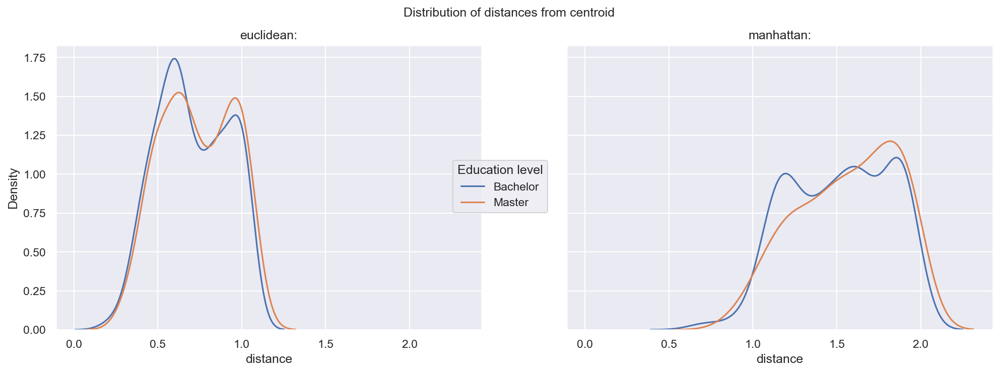

In [183]:
fig, axes = plt.subplots(1, 2, sharex=True, sharey=True, figsize=(16, 5), dpi=150)

for l in data.Level.unique():
    sns.distplot(data[data.Level == l]['eu_distance'], hist=False, label=l, ax=axes[0])
    sns.distplot(data[data.Level == l]['manh_distance'], hist=False, label=l, ax=axes[1])
    
axes[0].title.set_text('euclidean:')
axes[1].title.set_text('manhattan:')
axes[0].set(xlabel='distance')
axes[1].set(xlabel='distance')

fig.legend(labels=data.Level.unique(),
           loc='center',   # Position of legend
           borderaxespad=0.1,    # Small spacing around legend box
           title="Education level"  # Title for the legend
           )

fig.suptitle('Distribution of distances from centroid')
plt.savefig('distance_didtrib.jpeg')
plt.show()

C:\ProgramData\Anaconda3\lib\site-packages\seaborn\distributions.py:2557: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `kdeplot` (an axes-level function for kernel density plots).

C:\ProgramData\Anaconda3\lib\site-packages\seaborn\distributions.py:2557: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `kdeplot` (an axes-level function for kernel density plots).

C:\ProgramData\Anaconda3\lib\site-packages\seaborn\distributions.py:2557: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `kdeplot` (an axes-level function for kernel density plots).

C:\Program

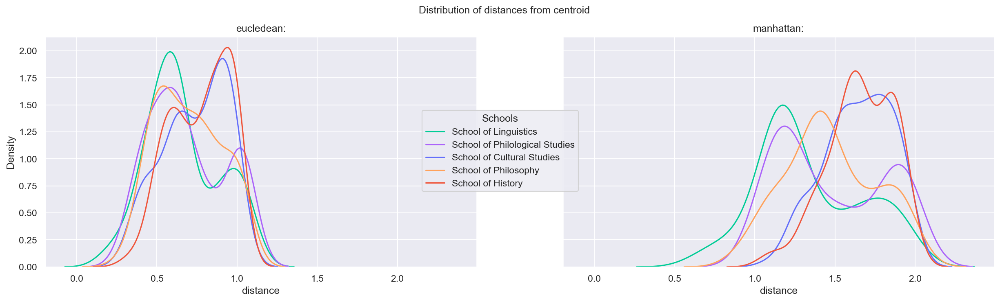

In [194]:
fig, axes = plt.subplots(1, 2, sharex=True, sharey=True, figsize=(20, 5), dpi=150)  

for l in data.School.unique():
    sns.distplot(data[data.School == l]['eu_distance'], hist=False, label=l, color=en_colors[l], ax=axes[0])
    sns.distplot(data[data.School == l]['manh_distance'], hist=False, label=l, color=en_colors[l], ax=axes[1])
    
axes[0].title.set_text('eucledean:')
axes[1].title.set_text('manhattan:')
axes[0].set(xlabel='distance')
axes[1].set(xlabel='distance')
fig.suptitle('Distribution of distances from centroid')
fig.legend(labels=data.School.unique(),
    loc="center",   # Position of legend
           borderaxespad=0.1,    # Small spacing around legend box
           title="Schools"  # Title for the legend
           )
plt.savefig('school_distances.jpeg')
plt.show()

C:\ProgramData\Anaconda3\lib\site-packages\ipykernel\ipkernel.py:287: DeprecationWarning:

`should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.



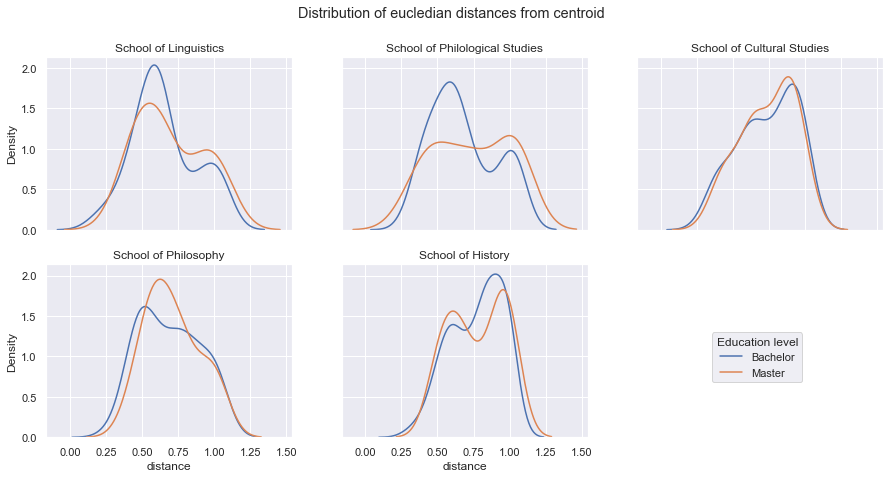

In [1666]:
fig, axes = plt.subplots(2, 3, sharex=True, sharey=True, figsize=(15, 7))

for i, s in enumerate(data.School.unique()):
    
    ax1 = 0 if i < 3 else 1
    ax2 = i if i < 3 else i-3
    
    axes[ax1, ax2].title.set_text(s)
    if ax1 == 1:
        axes[ax1, ax2].set(xlabel='distance')
    
    for l in data.Level.unique():
        sns.kdeplot(data[ (data.School == s) & (data.Level == l) ]['eu_distance'],
                     label=l, ax=axes[ax1, ax2])
axes[-1, -1].set_visible(False)
fig.legend(labels=data.Level.unique(),
           loc=(0.8, 0.2),   # Position of legend
           borderaxespad=0.1,    # Small spacing around legend box
           title="Education level"  # Title for the legend
           )
fig.suptitle('Distribution of eucledian distances from centroid')
plt.show()

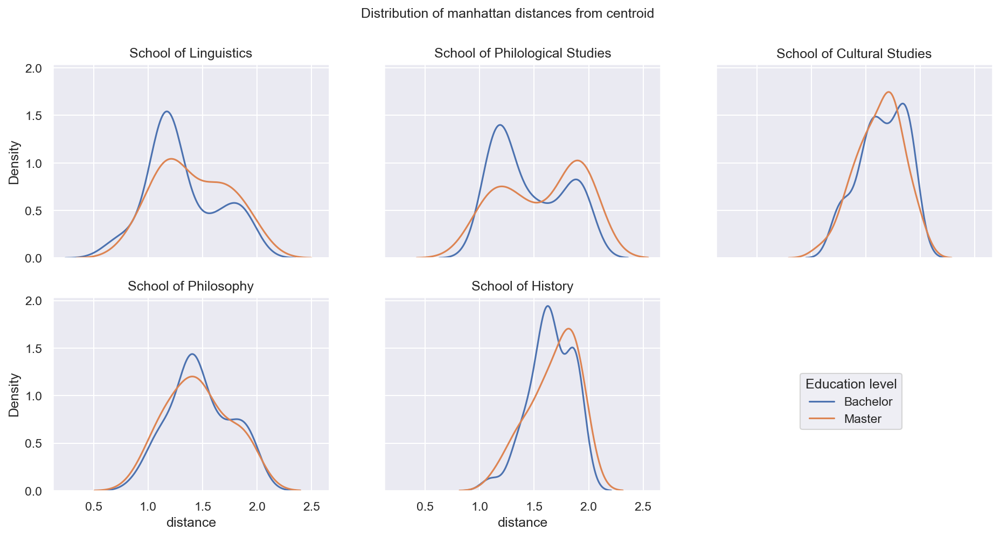

In [185]:
fig, axes = plt.subplots(2, 3, sharex=True, sharey=True, figsize=(15, 7), dpi=150)


for i, s in enumerate(data.School.unique()):
    
    ax1 = 0 if i < 3 else 1
    ax2 = i if i < 3 else i-3
    
    axes[ax1, ax2].title.set_text(s)
    if ax1 == 1:
        axes[ax1, ax2].set(xlabel='distance')
    
    for l in data.Level.unique():
        sns.kdeplot(data[ (data.School == s) & (data.Level == l) ]['manh_distance'],
                     label=l, ax=axes[ax1, ax2])
    
        
axes[-1, -1].set_visible(False)
fig.legend(labels=data.Level.unique(),
           loc=(0.8, 0.2),   # Position of legend
           borderaxespad=0.1,    # Small spacing around legend box
           title="Education level"  # Title for the legend
           )
        
fig.suptitle('Distribution of manhattan distances from centroid')
plt.savefig('dist_manh.jpeg')
plt.show()

In [187]:
distances_df = pd.DataFrame(columns=['Level', 'School', 'Program', 'mean_eu', 'mean_manh'])

for prog, g in data.groupby('Program'):
    eu = g['eu_distance'].mean()
    manh = g['manh_distance'].mean()
    
    distances_df = distances_df.append({'Level': g.Level.unique()[0],
                         'School': g.School.unique()[0],
                         'Program':prog,
                         'mean_eu': eu,
                         'mean_manh': manh},
                        ignore_index=True)
    
distances_df.sort_values('mean_eu', ascending=False)

,Level,School,Program,mean_eu,mean_manh
4,Master,School of Philological Studies,Cultural and Intellectual History: Between Eas...,1.045577,1.958092
9,Bachelor,School of History,History of Arts,0.908440,1.803367
11,Master,School of Philological Studies,Language Policy in the Context of Ethnocultura...,0.867468,1.871222
8,Master,School of History,History of Artistic Culture and the Art Market,0.827604,1.736141
14,Master,School of History,Medieval Studies,0.774296,1.744502
12,Master,School of Linguistics,Language Theory and Computational Linguistics,0.760072,1.484554
22,Master,School of Cultural Studies,Visual Culture,0.753487,1.622218
16,Master,School of Philosophy,Philosophical Anthropology,0.737951,1.506769
3,Bachelor,School of Cultural Studies,Cultural Studies,0.737796,1.654699
7,Bachelor,School of History,History,0.726447,1.604963


In [188]:
distances_df.sort_values('mean_manh', ascending=False)

,Level,School,Program,mean_eu,mean_manh
4,Master,School of Philological Studies,Cultural and Intellectual History: Between Eas...,1.045577,1.958092
11,Master,School of Philological Studies,Language Policy in the Context of Ethnocultura...,0.867468,1.871222
9,Bachelor,School of History,History of Arts,0.908440,1.803367
14,Master,School of History,Medieval Studies,0.774296,1.744502
8,Master,School of History,History of Artistic Culture and the Art Market,0.827604,1.736141
3,Bachelor,School of Cultural Studies,Cultural Studies,0.737796,1.654699
0,Master,School of Cultural Studies,Applied Cultural Studies,0.725004,1.630560
22,Master,School of Cultural Studies,Visual Culture,0.753487,1.622218
7,Bachelor,School of History,History,0.726447,1.604963
6,Master,School of History,Historical Knowledge,0.719664,1.578078


In [851]:
distances_df[['mean_eu', 'mean_manh']].corr()

,mean_eu,mean_manh
mean_eu,1.000000,0.917252
mean_manh,0.917252,1.000000


In [1672]:
data.groupby('School')['eu_distance'].mean().sort_values(ascending=False)

C:\ProgramData\Anaconda3\lib\site-packages\ipykernel\ipkernel.py:287: DeprecationWarning:

`should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.



School
School of History                 0.771551
School of Cultural Studies        0.739132
School of Philosophy              0.695610
School of Philological Studies    0.687201
School of Linguistics             0.661373
Name: eu_distance, dtype: float64

In [1673]:
data.groupby('School')['manh_distance'].mean().sort_values(ascending=False)

C:\ProgramData\Anaconda3\lib\site-packages\ipykernel\ipkernel.py:287: DeprecationWarning:

`should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.



School
School of History                 1.657841
School of Cultural Studies        1.644561
School of Philological Studies    1.476848
School of Philosophy              1.473173
School of Linguistics             1.336168
Name: manh_distance, dtype: float64

In [1674]:
data.groupby('Level')['eu_distance'].mean().sort_values(ascending=False)

C:\ProgramData\Anaconda3\lib\site-packages\ipykernel\ipkernel.py:287: DeprecationWarning:

`should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.



Level
Master      0.735165
Bachelor    0.707921
Name: eu_distance, dtype: float64

In [856]:
data.groupby('Level')['manh_distance'].mean().sort_values(ascending=False)

Level
Master      1.564588
Bachelor    1.516337
Name: manh_distance, dtype: float64

In [1001]:
data.head()

,File,ID,Title,Program,Level,School,vector,pca-one,pca-two,pca-three,...,tsne-pca10-two,tsne-pca103d-one,tsne-pca103d-two,tsne-pca103d-three,mean_vector,pca-5D-1,pca-5D-2,pca-5D-3,pca-5D-4,pca-5D-5
0,153006854.txt,153006854,Разработка словаря для автоматического извлече...,Фундаментальная и компьютерная лингвистика,Bachelor,Школа лингвистики,"[3.5413806e-05, 0.049679708, 2.760567e-05, 2.4...",-0.301390,0.630691,0.008960,...,-13.319227,10.834385,8.228337,7.190028,0.02,-0.301403,0.630711,0.009015,-0.091835,0.056550
1,153007241.txt,153007241,Травелоги В. П. Аксенова 1970-х гг.: поэтика и...,Филология,Bachelor,Школа филологических наук,"[1.6487642e-05, 1.4444807e-05, 1.2852399e-05, ...",0.501241,0.068701,-0.207452,...,11.073521,-3.810315,1.025705,-15.068878,0.02,0.501226,0.068696,-0.207460,-0.091786,0.005702
2,153007355.txt,153007355,Разграничение значений предлогов В (включеннос...,Фундаментальная и компьютерная лингвистика,Bachelor,Школа лингвистики,"[4.3028245e-05, 3.769703e-05, 3.3541284e-05, 3...",-0.235876,0.460658,-0.001318,...,-12.270507,8.573003,8.551085,5.354910,0.02,-0.235883,0.460859,-0.001775,-0.020212,0.039587
3,153007391.txt,153007391,«Science art: трансформация научного дискурса ...,Визуальная культура,Master,Школа культурологии,"[0.010373313, 3.1613006e-05, 2.812796e-05, 2.5...",-0.084665,-0.065841,0.010646,...,-1.938394,-2.415885,-2.802891,14.007454,0.02,-0.084488,-0.065964,0.010118,0.317299,-0.030820
4,153007477.txt,153007477,Разработка учебного модуля по глаголам движени...,Фундаментальная и компьютерная лингвистика,Bachelor,Школа лингвистики,"[3.2027696e-05, 2.805945e-05, 2.4966155e-05, 2...",-0.368485,0.831623,-0.024979,...,-13.919727,6.174109,4.718184,11.911150,0.02,-0.368486,0.831565,-0.024764,-0.120657,0.034789


Same but for the coordinates after PCA (not included as part of the analysis, just for the visual purposes)

In [1005]:
def get_distance_pca(vec, school):
    
    vec2 = centroids_5D[centroids_5D.School == school][[f'5d{i+1}' for i in range(5)]].values

    return euclidean(vec, vec2)

In [1100]:
data['distance'] = data.apply(lambda x: get_distance_pca(
    x[[f'pca-5D-{i+1}' for i in range(5)]].values,
    x['School']), axis=1)

data.groupby('Level')['distance'].mean().sort_values(ascending=False)

Level
Master      0.313900
Bachelor    0.297411
Name: distance, dtype: float64

In [1445]:
data.groupby(['School', 'Level'])['distance'].mean()

School                          Level   
School of Cultural Studies      Bachelor    0.189873
                                Master      0.286733
School of History               Bachelor    0.376566
                                Master      0.373702
School of Linguistics           Bachelor    0.283023
                                Master      0.301861
School of Philological Studies  Bachelor    0.326660
                                Master      0.342505
School of Philosophy            Bachelor    0.244827
                                Master      0.245872
Name: distance, dtype: float64

C:\ProgramData\Anaconda3\lib\site-packages\seaborn\distributions.py:2557: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `kdeplot` (an axes-level function for kernel density plots).

C:\ProgramData\Anaconda3\lib\site-packages\seaborn\distributions.py:2557: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `kdeplot` (an axes-level function for kernel density plots).



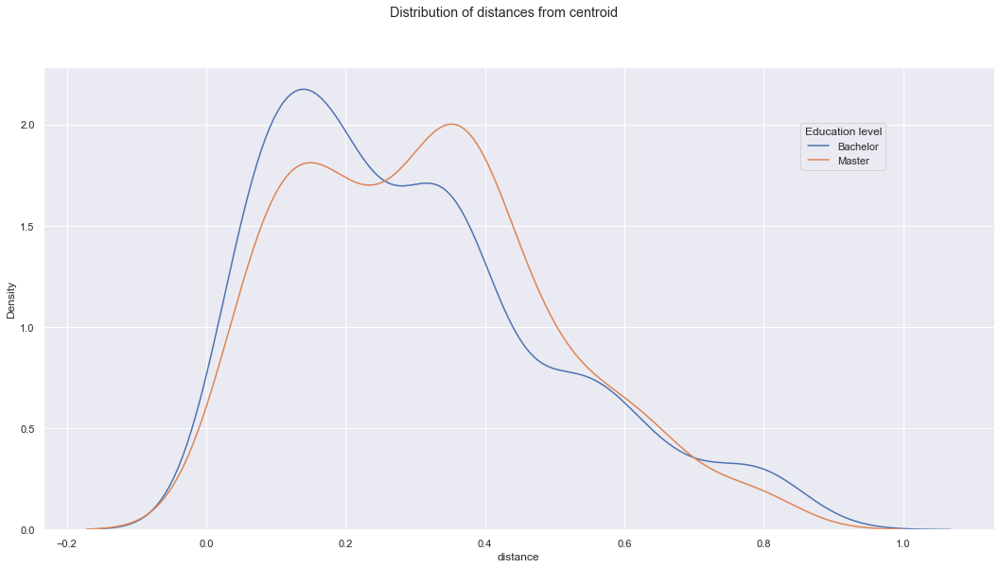

In [1101]:
fig = plt.figure(figsize=(18, 9))

for l in data.Level.unique():
    sns.distplot(data[data.Level == l]['distance'], hist=False, label=l)

fig.legend(labels=data.Level.unique(),
           loc=(0.8, 0.7),   # Position of legend
           borderaxespad=0.1,    # Small spacing around legend box
           title="Education level"  # Title for the legend
           )

fig.suptitle('Distribution of distances from centroid')
plt.show()

C:\ProgramData\Anaconda3\lib\site-packages\ipykernel\ipkernel.py:287: DeprecationWarning:

`should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.

C:\ProgramData\Anaconda3\lib\site-packages\seaborn\distributions.py:2557: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `kdeplot` (an axes-level function for kernel density plots).

C:\ProgramData\Anaconda3\lib\site-packages\seaborn\distributions.py:2557: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `kdeplot` (an axes-level function for kernel density plots).

C:\Progra

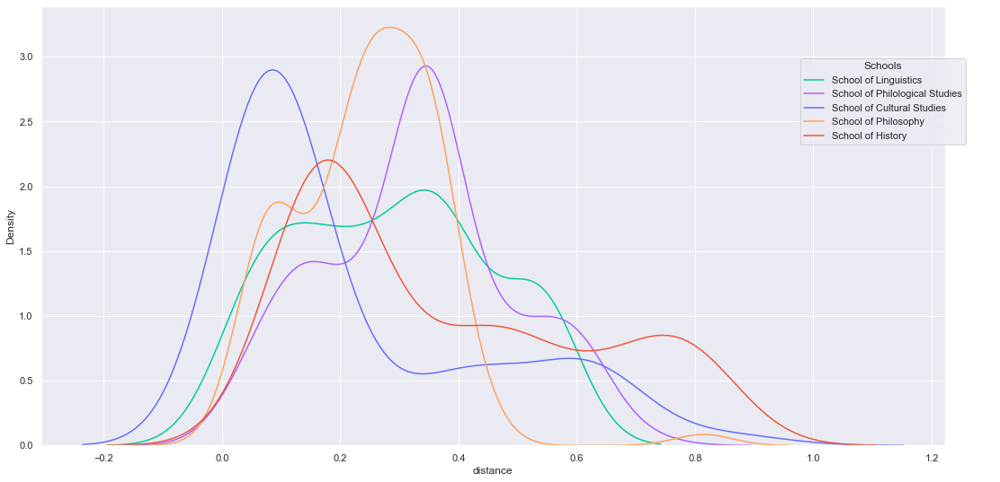

In [1675]:
fig = plt.figure(figsize=(18, 9))

for l in data.School.unique():
    sns.distplot(data[data.School == l]['distance'], hist=False, label=l, color=en_colors[l])
    

fig.legend(labels=data.School.unique(),
           loc=(0.8, 0.7),   # Position of legend
           borderaxespad=0.1,    # Small spacing around legend box
           title="Schools"  # Title for the legend
           )

plt.show()

C:\ProgramData\Anaconda3\lib\site-packages\ipykernel\ipkernel.py:287: DeprecationWarning:

`should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.



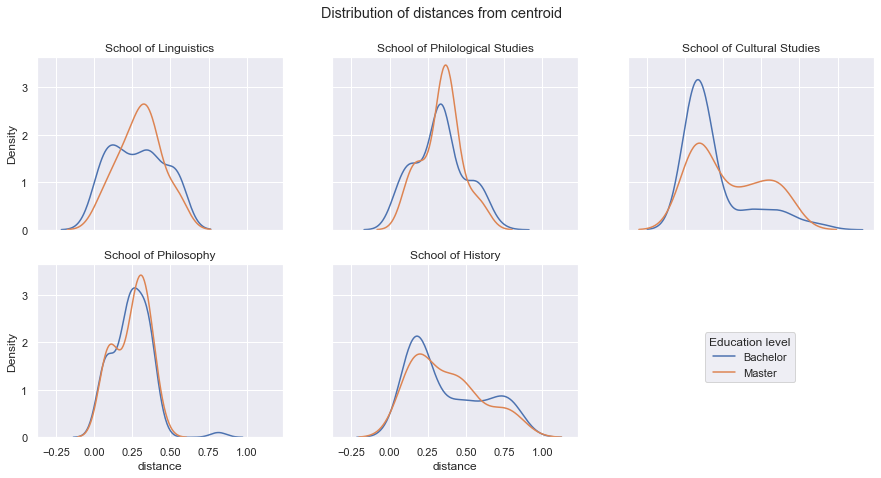

In [1676]:
fig, axes = plt.subplots(2, 3, sharex=True, sharey=True, figsize=(15, 7))

for i, s in enumerate(data.School.unique()):
    
    ax1 = 0 if i < 3 else 1
    ax2 = i if i < 3 else i-3
    
    axes[ax1, ax2].title.set_text(s)
    if ax1 == 1:
        axes[ax1, ax2].set(xlabel='distance')
    
    for l in data.Level.unique():
        sns.kdeplot(data[ (data.School == s) & (data.Level == l) ]['distance'],
                     label=l, ax=axes[ax1, ax2])
axes[-1, -1].set_visible(False)
fig.legend(labels=data.Level.unique(),
           loc=(0.8, 0.2),   # Position of legend
           borderaxespad=0.1,    # Small spacing around legend box
           title="Education level"  # Title for the legend
           )
fig.suptitle('Distribution of distances from centroid')
plt.show()

In [1107]:
distances_df_2 = pd.DataFrame(columns=['Level', 'School', 'Programe', 'mean_distance'])

for prog, g in data.groupby('Program'):
    dist = g['distance'].mean()
    
    distances_df_2 = distances_df_2.append({'Level': g.Level.unique()[0],
                         'School': g.School.unique()[0],
                         'Programe':prog,
                         'mean_distance': dist},
                        ignore_index=True)
    
distances_df_2.sort_values('mean_distance', ascending=False)

,Level,School,Programe,mean_distance
2,Bachelor,Школа исторических наук,История,0.411965
14,Master,Школа лингвистики,Русский как иностранный во взаимодействии язык...,0.410962
5,Master,Школа исторических наук,История художественной культуры и рынок искусства,0.402509
22,Master,Школа филологических наук,Языковая политика в условиях этнокультурного р...,0.394591
3,Master,Школа исторических наук,История знания и социальная история,0.370845
13,Master,Школа филологических наук,Русская литература и компаративистика,0.370182
1,Master,Школа исторических наук,Историческое знание,0.369236
8,Master,Школа филологических наук,Культурная и интеллектуальная история: между В...,0.360129
0,Master,Школа культурологии,Визуальная культура,0.347376
16,Bachelor,Школа филологических наук,Филология,0.326660


In [1288]:
filtered_data = data[
    (-0.1 < data[f'pca-5D-1']) & (data[f'pca-5D-1'] < 0.1) &
    (-0.1 < data[f'pca-5D-2']) & (data[f'pca-5D-2'] < 0.1) &
    (-0.1 < data[f'pca-5D-3']) & (data[f'pca-5D-3'] < 0.1) &
    (-0.1 < data[f'pca-5D-4']) & (data[f'pca-5D-4'] < 0.1) &
    (-0.1 < data[f'pca-5D-5']) & (data[f'pca-5D-5'] < 0.1) 
]

new_zero = [filtered_data[f'pca-5D-{i+1}'].mean() for i in range(5)]
new_zero

[-0.05390699895815393,
 -0.04038976246446139,
 0.008296816828506144,
 0.05474430637464171,
 -0.025498009868587784]

In [1273]:
new_zero = [data[f'pca-5D-{i+1}'].mean() for i in range(3)]
new_zero

[2.3553823251671248e-17, 1.469412826709766e-17, -4.513882539565948e-18]

In [5]:
def get_distance_zero(vec, zero=None):
    
    if zero is None:
        zero = [0]*len(vec)
        
    return euclidean(vec, zero)

def get_cosine_zero(vec, zero=None):
    
    if zero is None:
        zero = [0]*len(vec)
        
    return cosine(vec, zero)

In [1174]:
ends = pd.DataFrame(columns=['School', '5d1', '5d2', '5d3', '5d4', '5d5'])

for school, g in data.groupby('School'):
    
    top = g.sort_values('distance_new_zero', ascending=False).head(1)
    
    d1 = top['pca-5D-1'].values[0]
    d2 = top['pca-5D-2'].values[0]
    d3 = top['pca-5D-3'].values[0]
    d4 = top['pca-5D-4'].values[0]
    d5 = top['pca-5D-5'].values[0]
    
    ends = ends.append({'School': school,
                                  '5d1': d1,
                                  '5d2': d2,
                                  '5d3': d3,
                                  '5d4': d4,
                                  '5d5': d5
                                 },
                                 ignore_index=True)
    
ends['color'] = px.colors.qualitative.Plotly[:5]
ends

,School,5d1,5d2,5d3,5d4,5d5,color
0,Школа исторических наук,-0.081446,-0.202716,0.567938,-0.183096,0.668744,#636EFA
1,Школа культурологии,-0.081319,-0.201710,0.564081,-0.181135,0.664011,#EF553B
2,Школа лингвистики,-0.368597,0.831873,-0.024784,-0.120713,0.034799,#00CC96
3,Школа филологических наук,0.880168,0.213553,-0.068500,-0.033661,0.043813,#AB63FA
4,Школа философии,-0.126234,-0.224478,-0.525315,-0.227831,-0.064359,#FFA15A


In [1276]:
starts = pd.DataFrame(columns=['School', '5d1', '5d2', '5d3', '5d4', '5d5'])

for school, g in data.groupby('School'):
    
    top = g.sort_values('distance_new_zero', ascending=True).head(1)
    
    d1 = top['pca-5D-1'].values[0]
    d2 = top['pca-5D-2'].values[0]
    d3 = top['pca-5D-3'].values[0]
    d4 = top['pca-5D-4'].values[0]
    d5 = top['pca-5D-5'].values[0]
    
    starts = starts.append({'School': school,
                                  '5d1': d1,
                                  '5d2': d2,
                                  '5d3': d3,
                                  '5d4': d4,
                                  '5d5': d5
                                 },
                                 ignore_index=True)
    
starts['color'] = px.colors.qualitative.Plotly[:5]
starts

,School,5d1,5d2,5d3,5d4,5d5,color
0,Школа исторических наук,-0.021256,-0.034949,0.010562,0.056451,-0.020575,#636EFA
1,Школа культурологии,-0.029679,-0.040027,0.003703,0.057531,-0.005271,#EF553B
2,Школа лингвистики,-0.050203,-0.019240,0.006599,0.050569,-0.021888,#00CC96
3,Школа филологических наук,0.013545,-0.000937,-0.002826,0.045809,-0.016466,#AB63FA
4,Школа философии,-0.029497,-0.046060,-0.020166,0.040089,-0.021707,#FFA15A


In [1277]:
fig = px.scatter_3d(data.sort_values('School'), 
                    x='pca-5D-1', 
                    y='pca-5D-2', 
                    z='pca-5D-3',
                    color='School',
                    symbol='Level',
                    opacity=0.3,
                    custom_data=['School', 'Program', 'Level', 'Title'],
                    #color_discrete_sequence=px.colors.qualitative.Set2,
                   )

fig.update_traces(marker=dict(size=5),
                  selector=dict(mode='markers'))

for i in range(5):
    fig.add_scatter3d(
        x=[centroids_5D['5d1'][i]],
        y=[centroids_5D['5d2'][i]],
        z=[centroids_5D['5d3'][i]],
        
                mode="markers",
                name=centroids_5D['School'][i],
                marker=dict(size=10, color=centroids_5D['color'][i],
                            symbol='cross', opacity=0.8,
                           line=dict(width=2,
                                     color='black'))
               )


for i in range(5):
    fig.add_scatter3d(
        x=[new_zero[0], ends['5d1'][i]],
        y=[new_zero[1], ends['5d2'][i]],
        z=[new_zero[2], ends['5d3'][i]],
        
                mode="lines",
                name=ends['School'][i],
                  line=dict(width=2, color=ends['color'][i])
               )
    
    

    
text = "<br>".join([#"School: %{customdata[0]}",
                    "Level: %{customdata[2]}",
                    "Program: %{customdata[1]}",
                    "Title: %{customdata[3]}",
                    "<extra></extra>"
                   ])

fig.update_traces(marker_size=5,
                  hovertemplate=text,
                  selector=dict(mode='markers'))

fig.update_traces(hovertemplate="<extra></extra>",
                  selector=dict(mode='lines'))

fig.update_traces(marker_size=8, marker_line_width=1, marker_opacity=0.9,
                  hovertemplate="Centroid",
                  selector=dict(marker_symbol="cross"), overwrite=True)

fig.update_layout(margin=dict(l=0, r=0, b=0, t=0))
fig.show()

In [1177]:
fig.write_html("3D_centroids_lines.html")

In [6]:
centers_3D = data.groupby('School')[[f'pca-5D-{i+1}' for i in range(3)]].mean()
centers_3D

,pca-5D-1,pca-5D-2,pca-5D-3
School,,,
School of Cultural Studies,-0.063496,-0.087226,0.006159
School of History,-0.044190,-0.107991,0.143910
School of Linguistics,-0.187065,0.335932,0.000562
School of Philological Studies,0.278176,0.039585,-0.003612
School of Philosophy,-0.094351,-0.133039,-0.216181


Exploring the cosine distances

In [7]:
centers3D = dict([(s, [centers_3D[f'pca-5D-{ii+1}'][s] for ii in range(3)]) for s in centers_3D.index])
centers3D                     

{'School of Cultural Studies': [-0.06349622189479559,
  -0.0872255698602588,
  0.006159265625153059],
 'School of History': [-0.04418980296785214,
  -0.10799127128025883,
  0.14390987590139556],
 'School of Linguistics': [-0.1870649772421812,
  0.33593187378670625,
  0.0005615984490950652],
 'School of Philological Studies': [0.27817643108678747,
  0.039585305521265435,
  -0.003612209043295029],
 'School of Philosophy': [-0.09435096535408304,
  -0.1330387919925666,
  -0.2161809706599727]}

In [8]:
data['cosine_3'] = data.apply(lambda x: get_cosine_zero(
    x[[f'pca-5D-{i+1}' for i in range(3)]].values,
    centers3D[x.School]),
                              axis=1)


#get_cosine_zero(v, zero=[centers_3D[f'pca-5D-{i+1}'][s] for i in range(3)] for v, s in zip(data.vector, data.School)]

data.groupby('School')['cosine_3'].mean().sort_values(ascending=False)

School
School of Philological Studies    0.629269
School of History                 0.249525
School of Cultural Studies        0.206453
School of Linguistics             0.185636
School of Philosophy              0.138366
Name: cosine_3, dtype: float64

In [1782]:
for n in new_zero:
    r = round(n, 3)
    print(r-0.01, r+0.01)

-0.064 -0.044
-0.05 -0.03
-0.002 0.018000000000000002
0.045 0.065
-0.035 -0.015000000000000001


In [1783]:
filtered_data = data[
    (-0.064 > data[f'pca-5D-1']) | (data[f'pca-5D-1'] > -0.044) &
    (-0.05 > data[f'pca-5D-2']) | (data[f'pca-5D-2'] > 0.03) &
    (-0.002 > data[f'pca-5D-3']) | (data[f'pca-5D-3'] > 0.018)
].copy()

In [1787]:
for s, g in data.groupby('School'):
    
    print(s)
    for t in g.sort_values('cosine_3', ascending=False).head(5)['Title'].values:
        print('\t', t)

School of Cultural Studies
	 Poetics of the Social Criticism in the Russian Rock- and Rap-Poetry
	 Literature as an Alternative Writing Experience: the Case of Fedor Stepun
	 London Text of Russian Literature in the Second Half of the XIXth century
	 The Influence of Socio-cultural Environment on the Emergence and Development of Certain Kinds of Sport (Illustrated by The Olypmic and Paralympic Movements)
	 History Teaching in Soviet Schools (1917-1958), the case of the Tatar ASSR
School of History
	 Students, Scientists and Tricksters in the Works of Geoffrey Chaucer: Literary Traditions and Historical Context
	 Generational Synthesis Principle and the Problem of Reflections on Serfdom among Russian Peasantry after 1861
	 Savoraim in Mesopotamia and Midrash's Penetration into the Aramaic Exegetics
	 Personification of Death in "The Husbandman and Death" by Johannes von Tepl
	 Practices of Judical Settlement of Conflicts Between Nobles and Serfs in the 1760s–1770s in Russia
School of Li

In [1798]:
data[(data.Title == 'Language Situation in the Republic of Karelia: Current Ethnolinguistic Dynamics') |
     (data.Title == 'Attitude to Urban Multilingualism through the Prism of the Linguistic Landscape of Ulan-Ude')
    ][[f'pca-5D-{i+1}' for i in range(5)]]

,pca-5D-1,pca-5D-2,pca-5D-3,pca-5D-4,pca-5D-5
477,-0.069806,-0.032986,0.029465,0.068166,-0.028996
547,-0.069806,-0.032986,0.029464,0.068168,-0.028998


In [1833]:
x = data[(data.Title == 'Language Situation in the Republic of Karelia: Current Ethnolinguistic Dynamics') |
     (data.Title == 'Attitude to Urban Multilingualism through the Prism of the Linguistic Landscape of Ulan-Ude')
    ]['vector'].values

diff = []
for t1, t2 in zip(x[0], x[1]):
    diff.append(abs(t1 - t2)*1000)
    
for i in np.argsort(diff):
    print(i, diff[i], '\t', final_lda.show_topic(i, topn=5))

49 0.0005311360382620478 	 [('фильм', 0.012228939), ('зона', 0.0069279373), ('тарковский', 0.005703768), ('сценарий', 0.0051613497), ('повесть', 0.004885812)]
48 0.0005407805474533234 	 [('шаман', 0.005810131), ('деревня', 0.0035683466), ('мигрант', 0.003269584), ('племя', 0.0032489628), ('житель', 0.0032294684)]
47 0.0005507818059413694 	 [('поэт', 0.0056855534), ('стихотворение', 0.005235035), ('роман', 0.003959445), ('писатель', 0.0037303225), ('персонаж', 0.0026060108)]
46 0.0005611600499833003 	 [('храм', 0.0049175103), ('польский', 0.004910697), ('архитектор', 0.0037951085), ('марка', 0.0034852813), ('князь', 0.0034732728)]
45 0.0005719368800782831 	 [('фестиваль', 0.010876656), ('кластер', 0.006463045), ('burning', 0.004642698), ('фильм', 0.004053084), ('трагедия', 0.0038163795)]
44 0.0005831357157148886 	 [('субъект', 0.0047277766), ('бытие', 0.0038932678), ('крепостной', 0.0038070872), ('индивид', 0.0028136203), ('философия', 0.0027600257)]
43 0.000594781795371091 	 [('флешмоб

### Cosine distance


Back to full vectors

In [45]:
data['cosine_50'] = [get_cosine_zero(v, zero=centers[s]) for v, s in zip(data.vector, data.School)]

data.groupby('School')['cosine_50'].mean().sort_values(ascending=False)

School
School of Cultural Studies        0.670475
School of History                 0.647778
School of Philosophy              0.538748
School of Philological Studies    0.512658
School of Linguistics             0.441604
Name: cosine_50, dtype: float64

In [1710]:
data.groupby('Level')['cosine_50'].mean().sort_values(ascending=False)

Level
Master      0.611230
Bachelor    0.552847
Name: cosine_50, dtype: float64

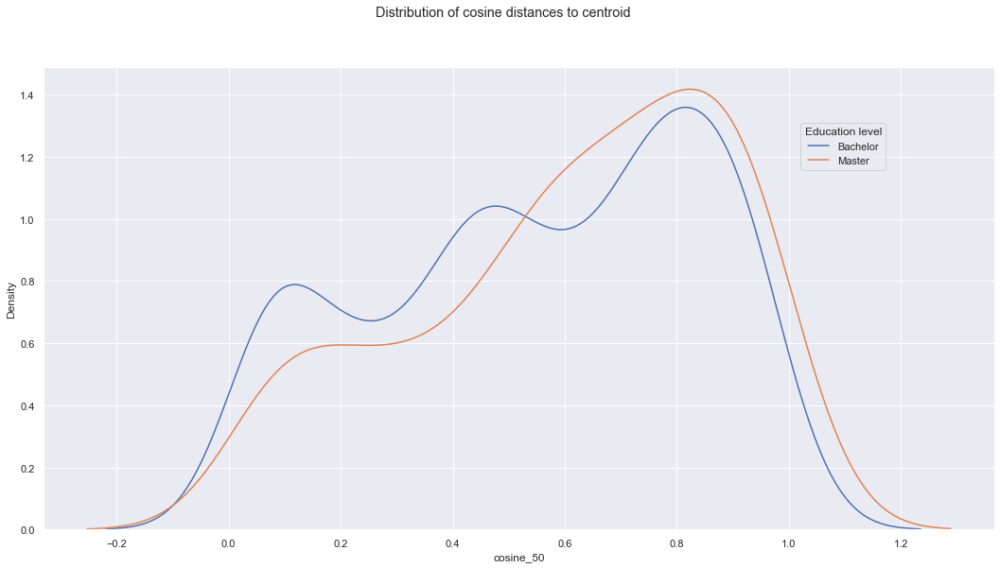

In [1711]:
fig = plt.figure(figsize=(18, 9))

for l in data.Level.unique():
    sns.distplot(data[data.Level == l]['cosine_50'], hist=False, label=l)

fig.legend(labels=data.Level.unique(),
           loc=(0.8, 0.7),   # Position of legend
           borderaxespad=0.1,    # Small spacing around legend box
           title="Education level"  # Title for the legend
           )

fig.suptitle('Distribution of cosine distances to centroid')
plt.show()

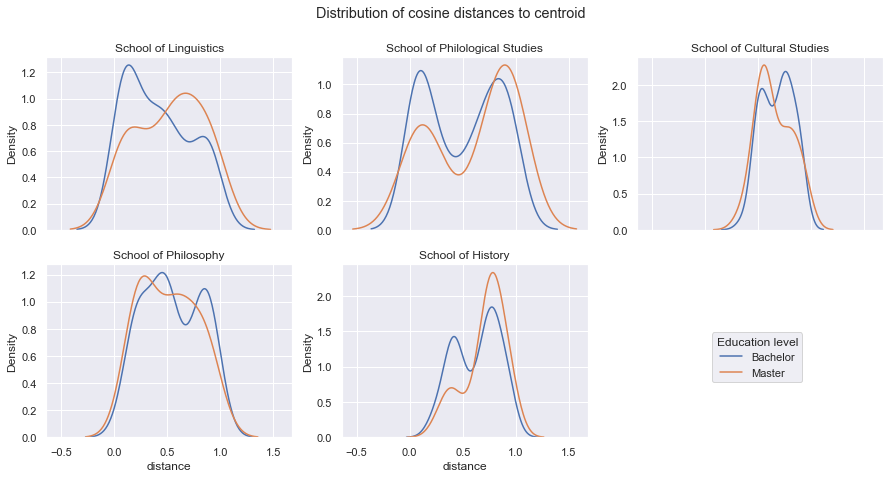

In [1692]:
fig, axes = plt.subplots(2, 3, sharex=True,  figsize=(15, 7)) #sharey=True,

for i, s in enumerate(data.School.unique()):
    
    ax1 = 0 if i < 3 else 1
    ax2 = i if i < 3 else i-3
    
    axes[ax1, ax2].title.set_text(s)
    if ax1 == 1:
        axes[ax1, ax2].set(xlabel='distance')
    
    for l in data.Level.unique():
        sns.kdeplot(data[ (data.School == s) & (data.Level == l) ]['cosine_50'],
                     label=l, ax=axes[ax1, ax2])
axes[-1, -1].set_visible(False)
fig.legend(labels=data.Level.unique(),
           loc=(0.8, 0.2),   # Position of legend
           borderaxespad=0.1,    # Small spacing around legend box
           title="Education level"  # Title for the legend
           )
fig.suptitle('Distribution of cosine distances to centroid')
plt.show()

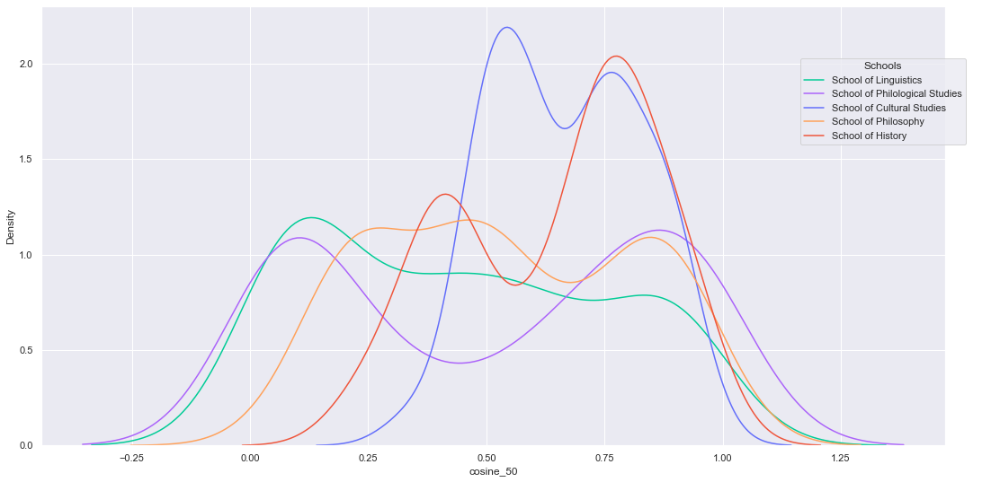

In [1691]:
fig = plt.figure(figsize=(18, 9))

for l in data.School.unique():
    sns.distplot(data[data.School == l]['cosine_50'], hist=False, label=l, color=en_colors[l])
    

fig.legend(labels=data.School.unique(),
           loc=(0.8, 0.7),   # Position of legend
           borderaxespad=0.1,    # Small spacing around legend box
           title="Schools"  # Title for the legend
           )

plt.show()

In [1695]:
cosine_results = data.groupby('Program').agg({
                             'cosine_50': 'mean',
                             'Title': 'count',
                             'School': 'max',
                                             }).sort_values('cosine_50', ascending=False)
cosine_results

,cosine_50,Title,School
Program,,,
Cultural and Intellectual History: Between East and West,0.966634,3,School of Philological Studies
Language Policy in the Context of Ethnocultural Diversity,0.923424,5,School of Philological Studies
Medieval Studies,0.817227,6,School of History
History of Arts,0.797697,27,School of History
History of Artistic Culture and the Art Market,0.770253,13,School of History
Applied Cultural Studies,0.684335,15,School of Cultural Studies
History of Knowledge and Social History,0.682198,3,School of History
Cultural Studies,0.679956,67,School of Cultural Studies
Visual Culture,0.630326,21,School of Cultural Studies


In [1696]:
cosine_results.corr()

,cosine_50,Title
cosine_50,1.000000,-0.172822
Title,-0.172822,1.000000


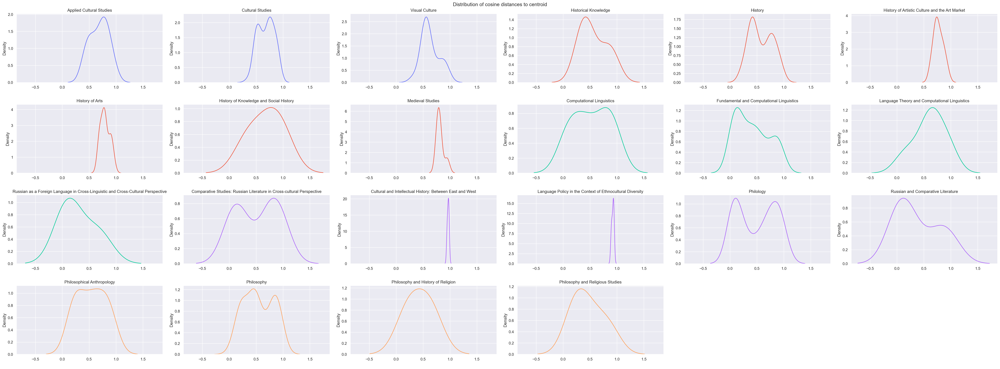

In [1698]:
fig = plt.figure(figsize=(40, 15), dpi=180) #sharey=True,

columns = 6
rows = 4

axes = []

n = 0

for s, g in data.groupby('School'):
    
    for p, group in g.groupby('Program'):
    

        if len(group) < 2:
            continue

        if n == 0:
            ax = fig.add_subplot(rows, columns, n+1)
        else:
            ax = fig.add_subplot(rows, columns, n+1, sharex=axes[n-1])

        ax.title.set_text(p)
        #ax.get_xaxis().set_visible(False)
        ax.set_xlabel(' ')

        axes.append(ax)


        sns.kdeplot(group['cosine_50'],
                         label=p, color=en_colors[s])

        n+=1
    

fig.suptitle('Distribution of cosine distances to centroid')
fig.tight_layout()
plt.savefig('programe_cosine_dist.png')
#plt.show()

In [189]:
distances_df = pd.DataFrame(columns=['Level', 'School', 'Program', 'mean_eu', 'mean_manh', 'mean_cos'])

for prog, g in data.groupby('Program'):
    eu = g['eu_distance'].mean()
    manh = g['manh_distance'].mean()
    cos = g['cosine_50'].mean()
    
    distances_df = distances_df.append({'Level': g.Level.unique()[0],
                         'School': g.School.unique()[0],
                         'Program':prog,
                         'mean_eu': eu,
                         'mean_manh': manh,
                         'mean_cos': cos},
                        ignore_index=True)
    
distances_df.sort_values('mean_manh', ascending=False)

,Level,School,Program,mean_eu,mean_manh,mean_cos
4,Master,School of Philological Studies,Cultural and Intellectual History: Between Eas...,1.045577,1.958092,0.966634
11,Master,School of Philological Studies,Language Policy in the Context of Ethnocultura...,0.867468,1.871222,0.923424
9,Bachelor,School of History,History of Arts,0.908440,1.803367,0.797697
14,Master,School of History,Medieval Studies,0.774296,1.744502,0.817227
8,Master,School of History,History of Artistic Culture and the Art Market,0.827604,1.736141,0.770253
3,Bachelor,School of Cultural Studies,Cultural Studies,0.737796,1.654699,0.679956
0,Master,School of Cultural Studies,Applied Cultural Studies,0.725004,1.630560,0.684335
22,Master,School of Cultural Studies,Visual Culture,0.753487,1.622218,0.630326
7,Bachelor,School of History,History,0.726447,1.604963,0.576930
6,Master,School of History,Historical Knowledge,0.719664,1.578078,0.565792


In [195]:
distances_df = pd.DataFrame(columns=['School', 'mean_eu', 'mean_manh', 'mean_cos'])

for prog, g in data.groupby('School'):
    eu = g['eu_distance'].mean()
    manh = g['manh_distance'].mean()
    cos = g['cosine_50'].mean()
    
    distances_df = distances_df.append({'School': g.School.unique()[0],
                         'mean_eu': eu,
                         'mean_manh': manh,
                         'mean_cos': cos},
                        ignore_index=True)
    
distances_df.sort_values('mean_cos', ascending=False)

,School,mean_eu,mean_manh,mean_cos
0,School of Cultural Studies,0.739132,1.644561,0.670475
1,School of History,0.771551,1.657841,0.647778
4,School of Philosophy,0.695610,1.473173,0.538748
3,School of Philological Studies,0.687201,1.476848,0.512658
2,School of Linguistics,0.661373,1.336168,0.441604


In [196]:
distances_df.corr()

,mean_eu,mean_manh,mean_cos
mean_eu,1.000000,0.961217,0.936966
mean_manh,0.961217,1.000000,0.985188
mean_cos,0.936966,0.985188,1.000000


Exploring programs scaled ny different measures

In [1724]:
mean_cols = ['mean_eu', 'mean_manh', 'mean_cos']

tops = []
bottoms = []

for m in mean_cols:
    t = distances_df.sort_values(m, ascending=False).head(5)['Program'].values
    tops.extend(list(t))
    b = distances_df.sort_values(m, ascending=False).tail(5)['Program'].values
    bottoms.extend(list(b))
    
dict(Counter(tops).most_common())

{'Cultural and Intellectual History: Between East and West': 3,
 'History of Arts': 3,
 'Language Policy in the Context of Ethnocultural Diversity': 3,
 'History of Artistic Culture and the Art Market': 3,
 'Medieval Studies': 3}

In [1725]:
dict(Counter(bottoms).most_common())

{'Fundamental and Computational Linguistics': 3,
 'Philosophy and Religious Studies': 3,
 'Russian as a Foreign Language in Cross-Linguistic and Cross-Cultural Perspective': 3,
 'Linguistic Theory and Language Description': 2,
 'Russian and Comparative Literature': 2,
 'Philosophy and History of Religion': 2}

Exploring individaul works per program/school

In [1734]:
for s, g in data.groupby('Program'):
    
    print(s)
    for t in g.sort_values('cosine_50', ascending=False).head(1)['Title'].values:
        print('\t', t)

Applied Cultural Studies
	 The Evolution of Profession of an Artist in Kyrgyzstan
Comparative Studies: Russian Literature in Cross-cultural Perspective
	 Adaptations of Strugatsky Brathers "Roadside picnic" for Cinema and Television
Computational Linguistics
	 Machine Translation of German Compound Nouns into Russian
Cultural Studies
	 Specific of Neo-Shamanism by the Example of Moscow Neo-Shamanie Community
Cultural and Intellectual History: Between East and West
	 The Phonetic Terminology in Russian Textbooks of Ancient Greek Language of the 19th - 20th Centuries: Formation and Contradictions
Fundamental and Computational Linguistics
	 Syntactic Properties of Nominalizations in Several Indo-European and Turkic Languages: Combinability with Nominal Arguments and Complement Clauses
Historical Knowledge
	 The Man of the Baroque in A.V. Mikhailov’s Historical Anthropology
History
	 History of Russian Universities in 1990s as a Research Problem
History of Artistic Culture and the Art Mark

In [1735]:
for s, g in data.groupby('School'):
    
    print(s)
    for t in g.sort_values('cosine_50', ascending=False).head(5)['Title'].values:
        print('\t', t)

School of Cultural Studies
	 Эстетика как эпистемология: когнитивистские стратегии в философии искусства и эстетике.
	 The Evolution of Profession of an Artist in Kyrgyzstan
	 Specific of Neo-Shamanism by the Example of Moscow Neo-Shamanie Community
	 Change of Family Traditions in Modern Tanzanian Cities
	 Collective Identity on the Counterculture Festival: Burning Man Case Study
School of History
	 Развитие проблематики философии сознания в советской философии и психологии 1920-1930-х гг.
	 History of Russian Universities in 1990s as a Research Problem
	 The Idea of Sculpture Renewal — the Technique ‘Taille Directe’ of Western European Masters and Russian Sculptor
	 Intellectuals at Court of Charles V: Political Thought and Discoursive Strategies
	 The Man of the Baroque in A.V. Mikhailov’s Historical Anthropology
School of Linguistics
	 Developing Linguistic Ontology for the Intellectual Property of Pharmaceutical Drugs
	 Machine Translation of German Compound Nouns into Russian
	 S

In [1755]:
for s, g in data.groupby('School'):
    
    print(s)
    for t in g.sort_values('cosine_50', ascending=False).tail(1)['Title'].values:
        print('\t', t)

School of Cultural Studies
	 Formation of Cyborg-subjectivity Within the Practice of the Contemporary Intermedial Theatre
School of History
	 The Soviet and Russian Historiography of the Wars of Spanish-American Independence (1810–1826)
School of Linguistics
	 Dialectal Lexemes in Ustja Basin Corpus
School of Philological Studies
	 The Perception of Russia and Russian People in Théophile Gautier's and Alexandre Dumas' Travelogues
School of Philosophy
	 The Temporality of Speech as a Horizon of Possible Ontology of Language


In [1754]:
for s, g in filtered_data.groupby('School'):
    
    print(s)
    for t in g.sort_values('distance_line', ascending=False).tail(1)['Title'].values:
        print('\t', t)

School of Cultural Studies
	 History of W. Benjamin’s Reception in the USA and Redefinition of the Role of an Intellectual in the Second Half of the XXth Century
School of History
	 Counterpropaganda in Soviet Cinema Studies in the Mid-1960s – Late 1980s: the Interaction of State Policy and Culture
School of Linguistics
	 Experimental Study of Palatalized vs. Velarized Consonants Followed by "E" in Loanwords
School of Philological Studies
	 Historical and Cultural Analysis of the Student Newspaper "Alma Mater" (Tartu)
School of Philosophy
	 L.N. Tolstoy and Russian Intelligentsia: a Philosophical Anallysis of Historical Conflicts


Exploring the idea of calculating disctance from a point to a line in 3D space

In [1256]:
def lineseg_dist(p, a, b):

    # normalized tangent vector
    d = np.divide(b - a, np.linalg.norm(b - a))

    # signed parallel distance components
    s = np.dot(a - p, d)
    t = np.dot(p - b, d)

    # clamped parallel distance
    h = np.maximum.reduce([s, t, 0])

    # perpendicular distance component
    c = np.cross(p - a, d)

    return np.hypot(h, np.linalg.norm(c))

In [1260]:
point = data[data.ID == '296295134'][[f'pca-5D-{i+1}' for i in range(5)]].values[0]
point

array([-0.29516043,  0.61896925, -0.01548356, -0.06782786,  0.0174825 ])

In [1261]:
a = starts[starts.School == 'Школа лингвистики'][[f'5d{i+1}' for i in range(5)]].values[0]
a

array([-0.04837446, -0.03706543,  0.01273063,  0.04884975, -0.02490018])

In [1262]:
b = ends[ends.School == 'Школа лингвистики'][[f'5d{i+1}' for i in range(5)]].values[0]
b

array([-0.36859705,  0.83187317, -0.02478448, -0.1207134 ,  0.03479888])

In [1263]:
lineseg_dist(point[:3], a[:3], b[:3])

0.004716615437760111

In [1257]:
lineseg_dist(point[:3], a[:3], b[:3])

0.2432248868140793

In [1287]:
data['distance_line'] = data.apply(lambda x: lineseg_dist(
    
    p = x[[f'pca-5D-{i+1}' for i in range(3)]].values[0],
    
    a = starts[starts.School == x['School']][[f'5d{i+1}' for i in range(3)]].values[0],
    
    b = ends[ends.School == x['School']][[f'5d{i+1}' for i in range(3)]].values[0]
),
    axis=1)

data.groupby('School')['distance_line'].mean().sort_values(ascending=False)

School
Школа филологических наук    0.417443
Школа лингвистики            0.299222
Школа исторических наук      0.112333
Школа культурологии          0.097695
Школа философии              0.055208
Name: distance_line, dtype: float64

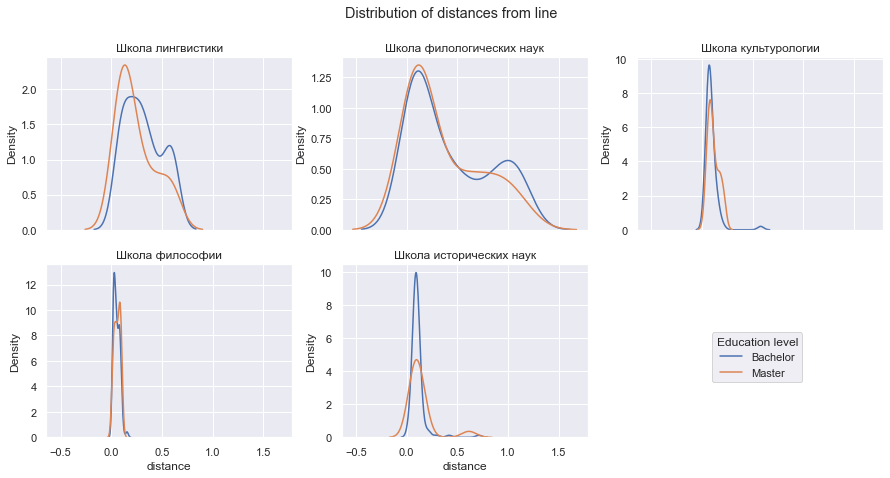

In [1279]:
fig, axes = plt.subplots(2, 3, sharex=True,  figsize=(15, 7)) #sharey=True,

for i, s in enumerate(data.School.unique()):
    
    ax1 = 0 if i < 3 else 1
    ax2 = i if i < 3 else i-3
    
    axes[ax1, ax2].title.set_text(s)
    if ax1 == 1:
        axes[ax1, ax2].set(xlabel='distance')
    
    for l in data.Level.unique():
        sns.kdeplot(data[ (data.School == s) & (data.Level == l) ]['distance_line'],
                     label=l, ax=axes[ax1, ax2])
axes[-1, -1].set_visible(False)
fig.legend(labels=data.Level.unique(),
           loc=(0.8, 0.2),   # Position of legend
           borderaxespad=0.1,    # Small spacing around legend box
           title="Education level"  # Title for the legend
           )
fig.suptitle('Distribution of distances from line')
plt.show()

Exploring the idea of fitting a line via linear regression (not very successfull)

In [1366]:
from sklearn import datasets, linear_model
from sklearn.metrics import mean_squared_error, r2_score

In [1405]:
lines = pd.DataFrame(columns=['School', 'x', 'y', 'z'])

for school, g in data.groupby('School'):
    
    d1 = g['pca-5D-1'].values
    d2 = g['pca-5D-2'].values
    d3 = g['pca-5D-3'].values
    
    train = np.array([d1, d2])
    
    c0 = [g[g.distance_new_zero == g.distance_new_zero.min()]['pca-5D-1'].values[0],
          g[g.distance_new_zero == g.distance_new_zero.max()]['pca-5D-1'].values[0]]
    
    regr1 = linear_model.LinearRegression()
    regr1.fit(d1.reshape(-1, 1),
              d2)
    
    c1 = [regr1.predict(c0[0].reshape(-1, 1))[0],
          regr1.predict(c0[1].reshape(-1, 1))[0]]
    
    regr2 = linear_model.LinearRegression()
    regr2.fit(d2.reshape(-1, 1),
              d3)
    c2 = [regr2.predict(c1[0].reshape(-1, 1))[0],
          regr2.predict(c1[1].reshape(-1, 1))[0]]
    
    lines = lines.append({
        'School': school,
        'x': c0,
        'y': c1,
        'z': c2
    }, ignore_index=True)

lines['color'] = px.colors.qualitative.Plotly[:5]
lines.index = lines.School
lines

,School,x,y,z,color
School,,,,,
Школа исторических наук,Школа исторических наук,"[-0.021255751192036543, -0.08144644774643109]","[-0.10119086042270159, -0.11903862105277375]","[0.1309381989072283, 0.16498252223002136]",#636EFA
Школа культурологии,Школа культурологии,"[-0.029679426712271906, -0.08131891441865462]","[-0.06304722573511125, -0.09996844483562775]","[0.026166557084597065, -0.0043853114701116885]",#EF553B
Школа лингвистики,Школа лингвистики,"[-0.05020326989612679, -0.3685970500959538]","[-0.011019427829448314, 0.7961247954082603]","[0.017735682720384366, -0.022217944328707304]",#00CC96
Школа филологических наук,Школа филологических наук,"[0.013544508421560547, 0.8801682810303965]","[-0.03611791684518708, 0.21179704180799086]","[0.02483658032670579, -0.06832828399381441]",#AB63FA
Школа философии,Школа философии,"[-0.029496960696244377, -0.12623422509483753]","[-0.04652612562392714, -0.17556979416042073]","[-0.0650725198093409, -0.2904682874249428]",#FFA15A


In [1406]:
fig = px.scatter_3d(data.sort_values('School'), 
                    x='pca-5D-1', 
                    y='pca-5D-2', 
                    z='pca-5D-3',
                    color='School',
                    symbol='Level',
                    opacity=0.3,
                    custom_data=['School', 'Program', 'Level', 'Title'],
                    #color_discrete_sequence=px.colors.qualitative.Set2,
                   )

fig.update_traces(marker=dict(size=5),
                  selector=dict(mode='markers'))

for i in range(5):
    fig.add_scatter3d(
        x=[centroids_5D['5d1'][i]],
        y=[centroids_5D['5d2'][i]],
        z=[centroids_5D['5d3'][i]],
        
                mode="markers",
                name=centroids_5D['School'][i],
                marker=dict(size=10, color=centroids_5D['color'][i],
                            symbol='cross', opacity=0.8,
                           line=dict(width=2,
                                     color='black'))
               )


for i in lines.School:
    fig.add_scatter3d(
        x=lines['x'][i],
        y=lines['y'][i],
        z=lines['z'][i],
        
                mode="lines",
                name=i,
                  line=dict(width=2, color=lines['color'][i])
               )
    
    

    
text = "<br>".join([#"School: %{customdata[0]}",
                    "Level: %{customdata[2]}",
                    "Program: %{customdata[1]}",
                    "Title: %{customdata[3]}",
                    "<extra></extra>"
                   ])

fig.update_traces(marker_size=5,
                  hovertemplate=text,
                  selector=dict(mode='markers'))

fig.update_traces(hovertemplate="<extra></extra>",
                  selector=dict(mode='lines'))

fig.update_traces(marker_size=8, marker_line_width=1, marker_opacity=0.9,
                  hovertemplate="Centroid",
                  selector=dict(marker_symbol="cross"), overwrite=True)

fig.update_layout(margin=dict(l=0, r=0, b=0, t=0))
fig.show()

In [10]:
data.to_csv('all_data.tsv', sep='\t')

#### Combined metric for measuring the interdisciplinarity of an individaul thesis

In [49]:
data['combined'] = data[['eu_distance', 'cosine_50']].sum(axis=1)

In [56]:
for s, g in data.groupby('School'):
    
    print(s)
    for t in g.sort_values('combined', ascending=False).head(5)['Title'].values:
        print('\t', t)

School of Cultural Studies
	 Poetics of the Social Criticism in the Russian Rock- and Rap-Poetry
	 Literature as an Alternative Writing Experience: the Case of Fedor Stepun
	 London Text of Russian Literature in the Second Half of the XIXth century
	 Genealogy of the Relation between Referent and Image in Portrait Studies
	 Everyday Design: Practices of Material Environments Structuring in Modern Individual's Lifeworld
School of History
	 Generational Synthesis Principle and the Problem of Reflections on Serfdom among Russian Peasantry after 1861
	 Students, Scientists and Tricksters in the Works of Geoffrey Chaucer: Literary Traditions and Historical Context
	 The War of the Pacific (1879–1883) and the Formation of National Identities in Chile, Peru and Bolivia
	 Practices of Judical Settlement of Conflicts Between Nobles and Serfs in the 1760s–1770s in Russia
	 Argumentation Strategies of Beguines' Advocates and Opponents in the First quarter of 14th Сentury: Appealing to Authority
S

In [60]:
for t in data.sort_values('cosine_3', ascending=False).head(5)['Title'].values:
        print('\t', t)

	 The Eastern Slavic Rite of "Kolodka": Context, Variants, Geography
	 Долгая судьба краткой формулы на материале памятников древнерусской письменности
	 Sociolinguistic Adaptation of Students from China Studying at Moscow Universities: Mixed-Method Research
	 Digital Approach to Iambic Trimeter in Ancient Greek Tragedy
	 Attitude to Urban Multilingualism through the Prism of the Linguistic Landscape of Ulan-Ude


In [62]:
for t in data.sort_values('eu_distance', ascending=False).head(5)['Title'].values:
        print('\t', t)

	 Developing Linguistic Ontology for the Intellectual Property of Pharmaceutical Drugs
	 Семантическое поле 'РУГАТЬ' в русском и английском языках
	 Adaptations of Strugatsky Brathers "Roadside picnic" for Cinema and Television
	 The Perception of R.D. Bradbury’s Works in the USSR in 1964 — 1984
	 Poems of Y. Zhadovskaya in the Pre-Revolutionary Literary Canon


In [63]:
for t in data.sort_values('distance_line', ascending=False).head(5)['Title'].values:
        print('\t', t)

	 The Poem of N. A. Nekrasov "Sasha" in Historical and Literary Context
	 The Function of Landscape in the Lyrics of N.A. Nekrasov
	 Story in Verse "Dorozhen'ka": Poetics, Literary Traditions, the Place in the Works of A. I. Solzhenitsyn
	 The German Translations of M. Lermontov’s Poetry (1840s – 1870s) and their Role in the Formation of the Lermontov Canon
	 The Image of Horace in Russian Poetry of the First Third of XIX Century


In [64]:
for t in data.sort_values('cosine_50', ascending=False).head(5)['Title'].values:
        print('\t', t)

	 Digital Approach to Iambic Trimeter in Ancient Greek Tragedy
	 Adaptations of Strugatsky Brathers "Roadside picnic" for Cinema and Television
	 Traditions of European Knowledge in 17th-Century Russia: The 1670 Translation of Albert the Great's Book
	 Poems of Y. Zhadovskaya in the Pre-Revolutionary Literary Canon
	 The Phonetic Terminology in Russian Textbooks of Ancient Greek Language of the 19th - 20th Centuries: Formation and Contradictions


In [65]:
for t in data.sort_values('combined', ascending=False).head(5)['Title'].values:
        print('\t', t)

	 Generational Synthesis Principle and the Problem of Reflections on Serfdom among Russian Peasantry after 1861
	 Students, Scientists and Tricksters in the Works of Geoffrey Chaucer: Literary Traditions and Historical Context
	 Poetics of the Social Criticism in the Russian Rock- and Rap-Poetry
	 The Poem of N. A. Nekrasov "Sasha" in Historical and Literary Context
	 The Function of Landscape in the Lyrics of N.A. Nekrasov


In [73]:
for s, g in data.groupby('School'):
    
    c = g['cosine_3'].min()
    d = g['eu_distance'].min() * 1.1
    
    g['combined'] = g.apply(lambda x:
                            abs(x['cosine_3']-c)+abs(x['eu_distance']-d) , axis=1)
    
    print(s)
    for t in g.sort_values('combined', ascending=False).head(5)['Title'].values:
        print('\t', t)

School of Cultural Studies
	 Literature as an Alternative Writing Experience: the Case of Fedor Stepun
	 Poetics of the Social Criticism in the Russian Rock- and Rap-Poetry
	 London Text of Russian Literature in the Second Half of the XIXth century
	 The Influence of Socio-cultural Environment on the Emergence and Development of Certain Kinds of Sport (Illustrated by The Olypmic and Paralympic Movements)
	 Adaptaion of the Migrant's Children in Moscow and Moscow Region Schools: Non-governmental Aspect
School of History
	 Students, Scientists and Tricksters in the Works of Geoffrey Chaucer: Literary Traditions and Historical Context
	 Practices of Judical Settlement of Conflicts Between Nobles and Serfs in the 1760s–1770s in Russia
	 Generational Synthesis Principle and the Problem of Reflections on Serfdom among Russian Peasantry after 1861
	 Personification of Death in "The Husbandman and Death" by Johannes von Tepl
	 Savoraim in Mesopotamia and Midrash's Penetration into the Aramaic 

In [75]:
data[['cosine_3', 'eu_distance']].describe()

,cosine_3,eu_distance
count,578.000000,578.000000
mean,0.306290,0.714520
std,0.506027,0.210927
min,0.000008,0.194790
25%,0.006619,0.548410
50%,0.048255,0.689281
75%,0.350697,0.902880
max,1.969110,1.085736


<AxesSubplot:xlabel='cosine_3'>

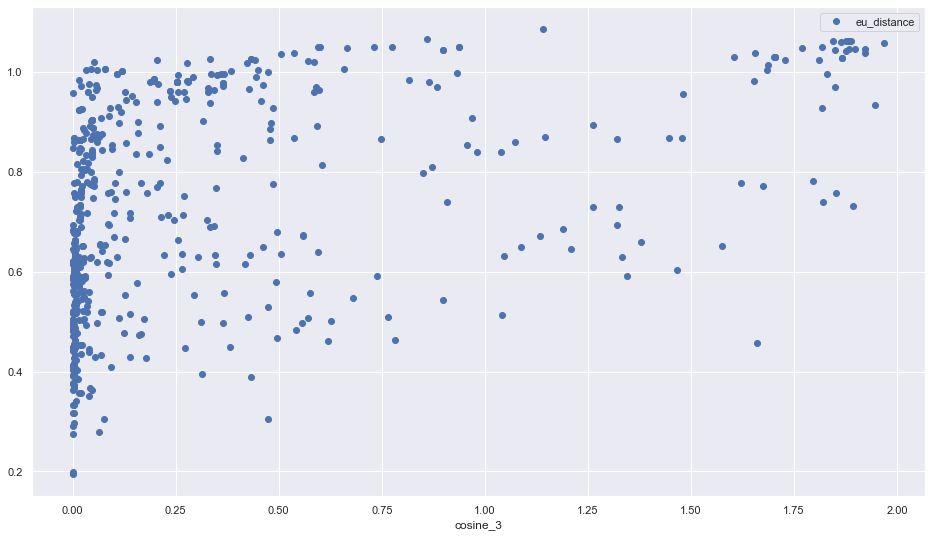

In [79]:
data.plot(x='cosine_3', y='eu_distance', style='o')

Truing to fit a curve to capture both cosine and ditance values of a thesis

In [80]:
from scipy.optimize import curve_fit

In [121]:
def objective(x, a, b, c, d):
    return ( b * (np.exp(a*x)**d) + c)

C:\ProgramData\Anaconda3\lib\site-packages\seaborn\_decorators.py:43: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


<AxesSubplot:xlabel='cosine_3', ylabel='eu_distance'>

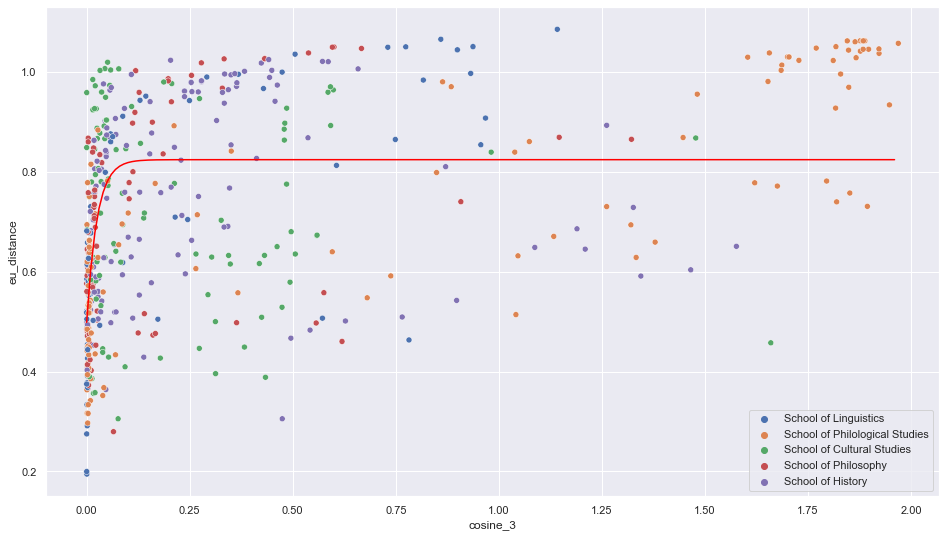

In [122]:
x = data['cosine_3']
y = data['eu_distance']

popt, _ = curve_fit(objective, x, y)
a, b, c, d = popt

x_line = np.arange(min(x), max(x), 0.01)
y_line = objective(x_line, a, b, c, d)

sns.scatterplot(x='cosine_3', y='eu_distance', data=data, hue='School')
sns.lineplot(x_line, y_line, color='red')

C:\ProgramData\Anaconda3\lib\site-packages\seaborn\_decorators.py:43: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


<AxesSubplot:xlabel='cosine_3', ylabel='eu_distance'>

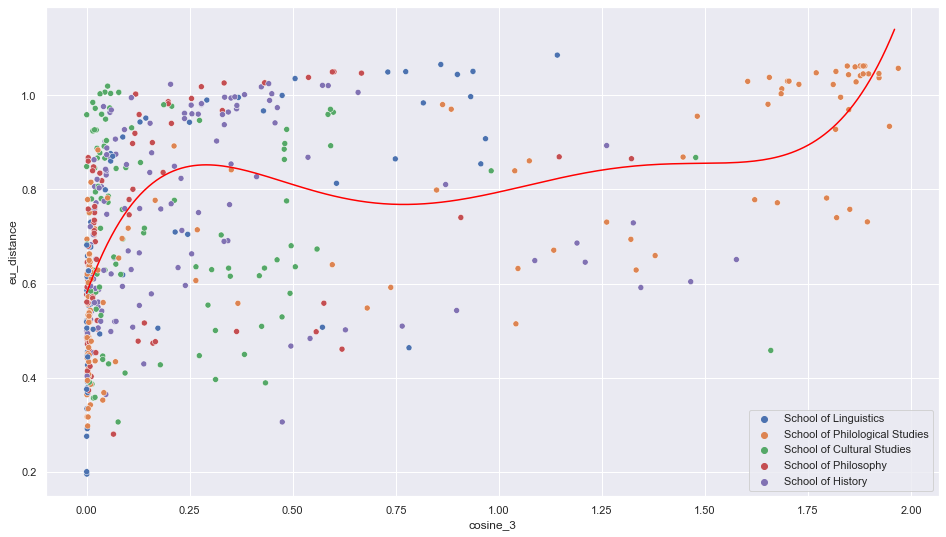

In [123]:
def objective(x, a, b, c, d, e, f):
    return (a * x) + (b * x**2) + (c * x**3) + (d * x**4) + (e * x**5) + f

x = data['cosine_3']
y = data['eu_distance']

popt, _ = curve_fit(objective, x, y)
a, b, c, d, e, f = popt

x_line = np.arange(min(x), max(x), 0.01)
y_line = objective(x_line, a, b, c, d, e, f)

sns.scatterplot(x='cosine_3', y='eu_distance', data=data, hue='School')
sns.lineplot(x_line, y_line, color='red')

C:\ProgramData\Anaconda3\lib\site-packages\seaborn\_decorators.py:43: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


<AxesSubplot:xlabel='cosine_3', ylabel='eu_distance'>

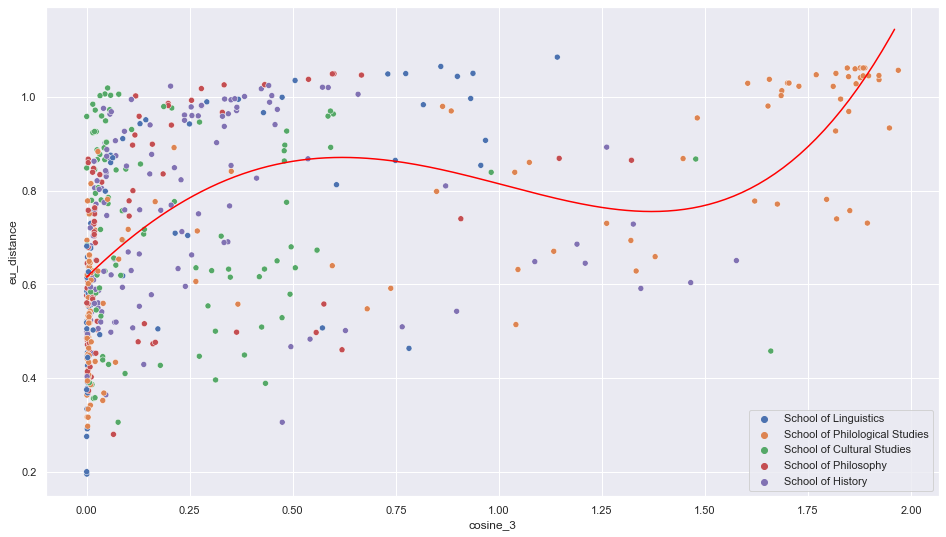

In [125]:
def objective(x, a, b, c, d):
    return a * np.sin(b - x) + c * x**2 + d


x = data['cosine_3']
y = data['eu_distance']

popt, _ = curve_fit(objective, x, y)
a, b, c, d = popt

x_line = np.arange(min(x), max(x), 0.01)
y_line = objective(x_line, a, b, c, d)

sns.scatterplot(x='cosine_3', y='eu_distance', data=data, hue='School')
sns.lineplot(x_line, y_line, color='red')

C:\ProgramData\Anaconda3\lib\site-packages\seaborn\_decorators.py:43: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning
C:\ProgramData\Anaconda3\lib\site-packages\seaborn\_decorators.py:43: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning
C:\ProgramData\Anaconda3\lib\site-packages\seaborn\_decorators.py:43: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning
C:\ProgramData\Anaconda3\

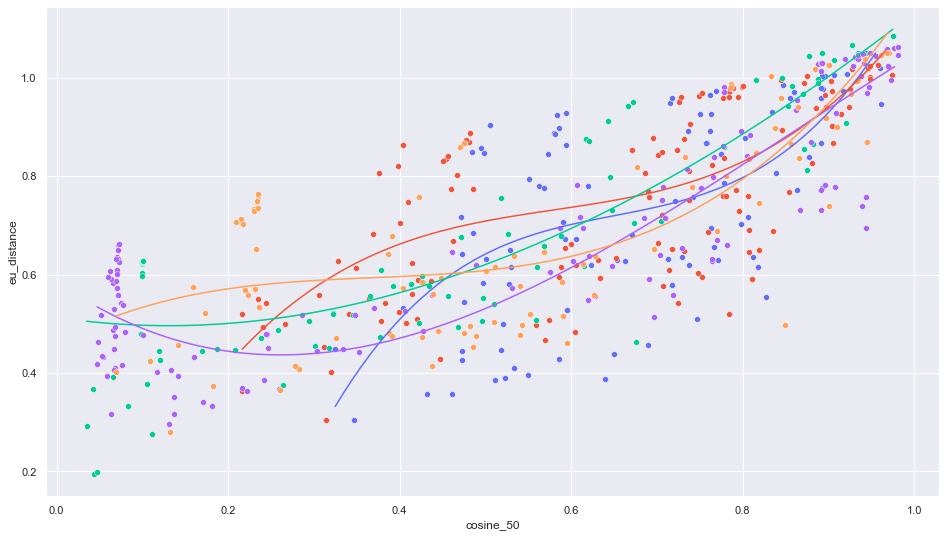

In [157]:
def objective(x, a, b, c, d):
    return (a * x) + (b * x**2) + (c * x**3) + d #(d * x**4) + (e * x**5) + (f * x**6) + h

popts = {}

for s, g in data.groupby('School'):


    x = g['cosine_50']
    y = g['eu_distance']

    popt, _ = curve_fit(objective, x, y)
    popts[s] = popt
    a, b, c, d = popt

    x_line = np.arange(min(x), max(x), 0.01)
    y_line = objective(x_line, a, b, c, d)

    sns.scatterplot(x='cosine_50', y='eu_distance', data=g, color=en_colors[s])
    sns.lineplot(x_line, y_line, color=en_colors[s])

In [158]:
def df_objective(x, popt):
    a, b, c, d = popt
    return (a * x) + (b * x**2) + (c * x**3) + d

def get_objective(c, s):
    
    return df_objective(c, popts[s])

In [159]:
data['objective'] = data.apply(lambda x: get_objective(x['cosine_3'], x['School']), axis=1)

for s, g in data.groupby('School'):
    
    print(s)
    for t in g.sort_values('objective', ascending=False).head(5)['Title'].values:
        print('\t', t)

School of Cultural Studies
	 Poetics of the Social Criticism in the Russian Rock- and Rap-Poetry
	 Literature as an Alternative Writing Experience: the Case of Fedor Stepun
	 London Text of Russian Literature in the Second Half of the XIXth century
	 The Influence of Socio-cultural Environment on the Emergence and Development of Certain Kinds of Sport (Illustrated by The Olypmic and Paralympic Movements)
	 History Teaching in Soviet Schools (1917-1958), the case of the Tatar ASSR
School of History
	 Students, Scientists and Tricksters in the Works of Geoffrey Chaucer: Literary Traditions and Historical Context
	 Generational Synthesis Principle and the Problem of Reflections on Serfdom among Russian Peasantry after 1861
	 Savoraim in Mesopotamia and Midrash's Penetration into the Aramaic Exegetics
	 Personification of Death in "The Husbandman and Death" by Johannes von Tepl
	 Practices of Judical Settlement of Conflicts Between Nobles and Serfs in the 1760s–1770s in Russia
School of Li

In [160]:
data.to_csv('final_data_dirty.tsv', sep='\t')

#### Topics

Looking at topics once again 

In [1628]:
import pyLDAvis.gensim_models

C:\ProgramData\Anaconda3\lib\site-packages\ipykernel\ipkernel.py:287: DeprecationWarning:

`should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.



In [1629]:
pyLDAvis.enable_notebook()
vis = pyLDAvis.gensim_models.prepare(final_lda, bow_corpus, dictionary)
vis

C:\ProgramData\Anaconda3\lib\site-packages\ipykernel\ipkernel.py:287: DeprecationWarning:

`should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.



PreparedData(topic_coordinates=              x         y  topics  cluster       Freq
topic                                                
47    -0.060635 -0.039953       1        1  10.873508
44    -0.038649  0.074997       2        1   6.730392
29    -0.062246 -0.072904       3        1   6.245368
1     -0.010013 -0.076407       4        1   5.605269
7     -0.053349 -0.030208       5        1   4.629573
10     0.206038  0.007564       6        1   4.383437
37    -0.023150  0.156888       7        1   4.225027
22    -0.024973 -0.027038       8        1   3.930768
14    -0.097245 -0.006024       9        1   3.586206
42    -0.014998  0.010055      10        1   3.455729
46    -0.076126 -0.122290      11        1   2.776552
0      0.033264  0.045605      12        1   2.393522
15     0.077423 -0.078441      13        1   2.363757
26    -0.017641  0.039462      14        1   2.289863
36    -0.024725 -0.001996      15        1   2.210377
20    -0.094168 -0.084107      16        1   1.906787
5     -0.018110  0.003634      17        1   1.852307
43     0.033270 -0.005980      18        1   1.829153
30    -0.080809 -0.107987      19        1   1.823873
16     0.007330 -0.027355      20        1   1.700465
21    -0.046973  0.071178      21        1   1.548909
19     0.016153  0.042922      22        1   1.532204
34    -0.041756  0.009064      23        1   1.448987
13    -0.043585 -0.080948      24        1   1.433857
17     0.191587 -0.017291      25        1   1.395468
41    -0.018374 -0.000233      26        1   1.286480
18    -0.045207  0.029170      27        1   1.126672
33    -0.041732  0.144255      28        1   1.123607
24     0.033953  0.000549      29        1   1.091975
23    -0.018188 -0.012771      30        1   1.074981
2     -0.002845  0.087310      31        1   1.053713
12    -0.009664 -0.007300      32        1   1.029244
31     0.088321 -0.055482      33        1   0.984064
11    -0.057859  0.076907      34        1   0.949120
27    -0.023137  0.039308      35        1   0.888765
9      0.014352 -0.023094      36        1   0.868605
39     0.135655 -0.060353      37        1   0.865606
6      0.091844  0.045639      38        1   0.841880
35    -0.027841  0.025165      39        1   0.739682
38     0.079221  0.004921      40        1   0.698328
4     -0.041130  0.028831      41        1   0.666859
48    -0.007096 -0.008032      42        1   0.546996
45     0.082282  0.002991      43        1   0.494003
25     0.027578  0.027887      44        1   0.474809
40    -0.011017 -0.008413      45        1   0.423037
49    -0.012203  0.013965      46        1   0.255635
8     -0.011394 -0.007723      47        1   0.192475
32     0.054678 -0.014347      48        1   0.104250
28    -0.007354 -0.003521      49        1   0.046557
3     -0.008758 -0.008069      50        1   0.001300, topic_info=               Term         Freq        Total Category  logprob  loglift
2637  стихотворение  1999.000000  1999.000000  Default  30.0000  30.0000
168          глагол  2814.000000  2814.000000  Default  29.0000  29.0000
3978       художник  3845.000000  3845.000000  Default  28.0000  28.0000
829           фильм  2528.000000  2528.000000  Default  27.0000  27.0000
7630           кант  1418.000000  1418.000000  Default  26.0000  26.0000
...             ...          ...          ...      ...      ...      ...
828     философский     0.019791  1654.251473  Topic50  -7.2103  -0.0832
2073       персонаж     0.021740  2574.614781  Topic50  -7.1163  -0.4317
7630           кант     0.018564  1418.633144  Topic50  -7.2742   0.0064
746         субъект     0.019925  2185.572469  Topic50  -7.2035  -0.3550
2618           ссср     0.019146  1795.931568  Topic50  -7.2434  -0.1985

[3444 rows x 6 columns], token_table=       Topic      Freq      Term
term                            
22605      1  0.084647  academia
22605      2  0.042324  academia
22605      8  0.042324  academia
22605     23  0.042324  academia
22605     30  0.719503  academia
... 

In [1682]:
import warnings
warnings.filterwarnings('ignore')

*Anna Polyanskaya, 2021*